In [13]:
import os
import math
import fnmatch
import skimage
import scipy as sp
import numpy as np
import pandas as pd
import nibabel as nib
from sklearn import mixture
import matplotlib.pyplot as plt
from skimage.transform import resize
from nibabel.testing import data_path
from skimage import data, io, filters, exposure
from skimage.morphology import remove_small_holes, binary_closing, remove_small_objects, label
from nibabel import processing
import csv
import time
import glob
import nibabel as nib
import pydicom

In [14]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', -1)

c:\users\e.lavrova\.conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
folder = "Z:/Lisa/PARISK/PARISK/MUMC116/"
for item in os.listdir(folder):
    path = os.path.join(folder, item)
    dcm = pydicom.read_file(path, force = True)
    dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
    print (dcm.SeriesDescription)
    print (item)
    img = dcm.pixel_array
    plt.imshow(img[int(img.shape[0]/2), ...])
    plt.show()

In [141]:
df = []
for item in os.listdir("Z:/Lisa/PARISK/PARISK_curated/"):
    folder = os.path.join("Z:/Lisa/PARISK/PARISK_curated/", item)
    if os.path.isdir(folder + '/MASSExport') and (os.path.isdir(folder + '/contours')):
        for filename in os.listdir(folder + '/MASSExport'):
            if filename[-4:] == '.dcm':
                sl = int(filename[-8:-4])
                dcm = pydicom.read_file(folder + '/MASSExport/' + filename, force = True)
                mod = dcm.SeriesDescription
                rec = {'sub': item, 'mod': mod, 'sl': sl}
                df.append(rec)
        for filename in os.listdir(folder + '/contours'):
            if filename[-4:] == '.dcm':
                sl = int(filename[-8:-4])
                rec = {'sub': item, 'mod': 'con', 'sl': sl}
                df.append(rec)

In [142]:
df = pd.DataFrame(df)

In [143]:
np.unique(np.array(list(df['mod'])))

array(['3DTOF', 'QIR TR800', 'QIR TR800 + contrast', 'QIR TR800 contrast',
       'T1-TFE', 'T1W 2D DIR', 'T1W 2D DIR + contrast', 'T2W MS TSE',
       'con'], dtype='<U21')

In [144]:
df.loc[df['mod'] == '3DTOF', 'contrast'] = 'TOF'
df.loc[df['mod'] == 'QIR TR800', 'contrast'] = 'T1w'
df.loc[df['mod'] == 'QIR TR800 + contrast', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'QIR TR800 contrast', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'T1-TFE', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1-TFE seattle', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1-TFE transversaal', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1W 2D DIR', 'contrast'] = 'T1w'
df.loc[df['mod'] == 'T1W 2D DIR + contrast', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'T2W MS TSE', 'contrast'] = 'T2w'
df.loc[df['mod'] == 'con', 'contrast'] = 'con'

df.loc[df['mod'] == '3DTOF\x00', 'contrast'] = 'TOF'
df.loc[df['mod'] == 'QIR TR800\x00', 'contrast'] = 'T1w'
df.loc[df['mod'] == 'QIR TR800 + contrast\x00', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'QIR TR800 contrast\x00', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'T1-TFE\x00', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1-TFE seattle\x00', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1-TFE transversaal\x00', 'contrast'] = 'MPRAGE'
df.loc[df['mod'] == 'T1W 2D DIR\x00', 'contrast'] = 'T1w'
df.loc[df['mod'] == 'T1W 2D DIR + contrast\x00', 'contrast'] = 'T1w_contrast'
df.loc[df['mod'] == 'T2W MS TSE\x00', 'contrast'] = 'T2w'
df.loc[df['mod'] == 'con\x00', 'contrast'] = 'con'

In [145]:
df_summary = []
for sub in np.unique(np.array(list(df['sub']))):
    df_sub = df[df['sub'] == sub].copy()
    len_T1w = len(df_sub[df_sub['contrast'] == 'T1w'])
    len_T1w_contrast = len(df_sub[df_sub['contrast'] == 'T1w_contrast'])
    len_TOF = len(df_sub[df_sub['contrast'] == 'TOF'])
    len_T2w = len(df_sub[df_sub['contrast'] == 'T2w'])
    len_MPRAGE = len(df_sub[df_sub['contrast'] == 'MPRAGE'])
    len_con = len(df_sub[df_sub['contrast'] == 'con'])
    sl_T1w = set(df_sub[df_sub['contrast'] == 'T1w']['sl'])
    sl_T1w_contrast = set(df_sub[df_sub['contrast'] == 'T1w_contrast']['sl'])
    sl_T2w = set(df_sub[df_sub['contrast'] == 'T2w']['sl'])
    sl_TOF = set(df_sub[df_sub['contrast'] == 'TOF']['sl'])
    sl_MPRAGE = set(df_sub[df_sub['contrast'] == 'MPRAGE']['sl'])
    sl_con = set(df_sub[df_sub['contrast'] == 'con']['sl'])
    slices = list(sl_T1w & sl_T1w_contrast & sl_T2w & sl_TOF & sl_MPRAGE & sl_con)
    rec = {'sub': sub, 
           'T1w': len_T1w, 'T1w_contrast': len_T1w_contrast, 'T2w': len_T2w, 'TOF': len_TOF, 'MPRAGE': len_MPRAGE, 
           'con': len_con,
           'slices': slices}
    df_summary.append(rec)

In [146]:
df_summary = pd.DataFrame(df_summary)
df_summary

,sub,T1w,T1w_contrast,T2w,TOF,MPRAGE,con,slices
0,MUMC011,14,14,14,14,14,14,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
1,MUMC013,15,15,15,15,15,15,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
2,MUMC014,14,14,14,14,14,14,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
3,MUMC015,14,14,14,14,14,14,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
4,MUMC016,14,14,14,14,14,14,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
5,MUMC017,14,14,14,14,14,14,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
6,MUMC019,13,13,13,13,13,13,"[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]"
7,MUMC020,14,14,14,14,14,14,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]"
8,MUMC021,14,14,14,14,14,14,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]"
9,MUMC022,14,14,14,14,14,14,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]"


MUMC011 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


c:\users\e.lavrova\.conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:45: UserWarning: No contour levels were found within the data range.
c:\users\e.lavrova\.conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:46: UserWarning: No contour levels were found within the data range.
c:\users\e.lavrova\.conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:47: UserWarning: No contour levels were found within the data range.


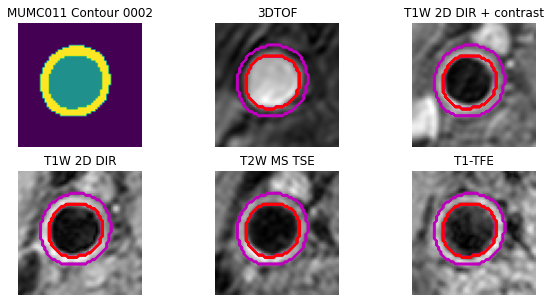

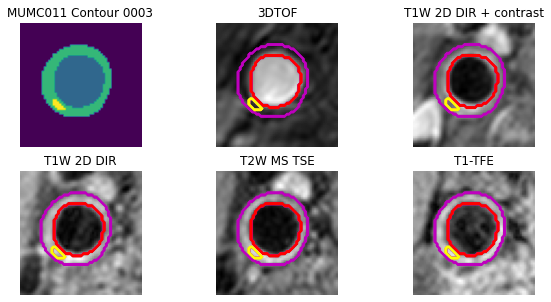

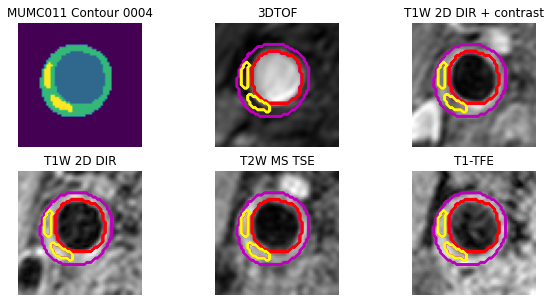

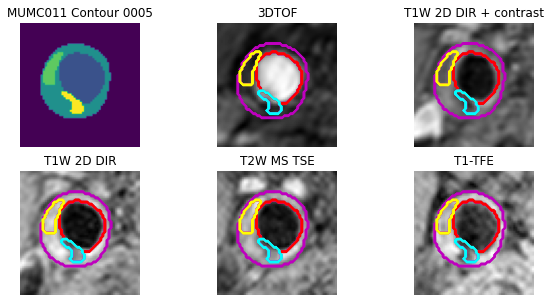

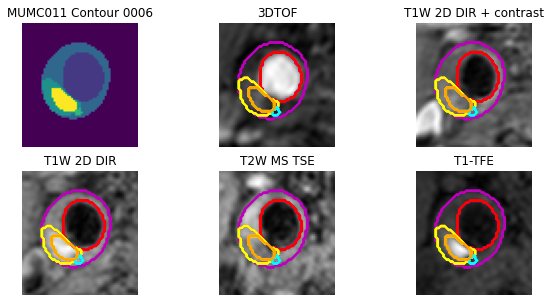

...

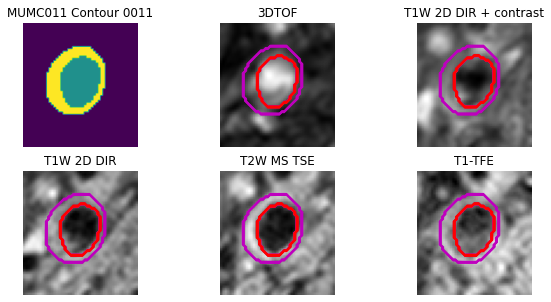

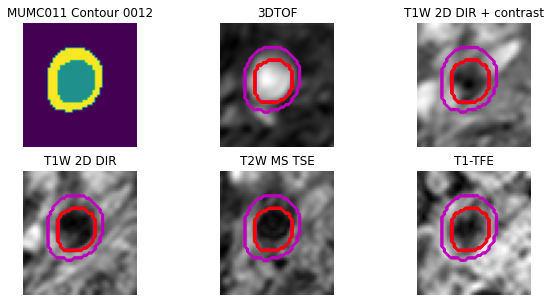

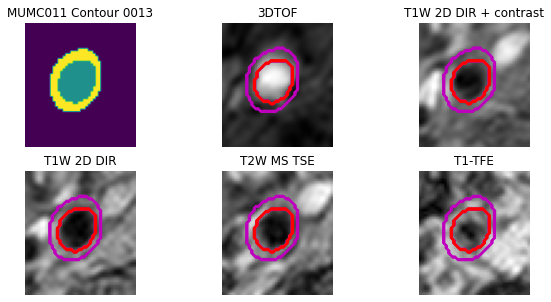

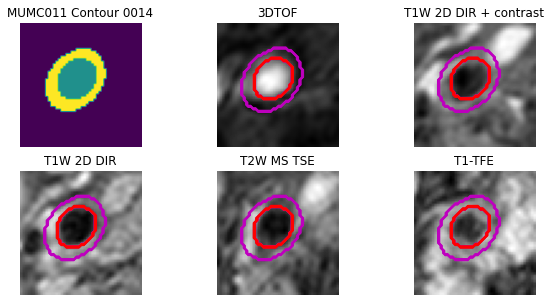

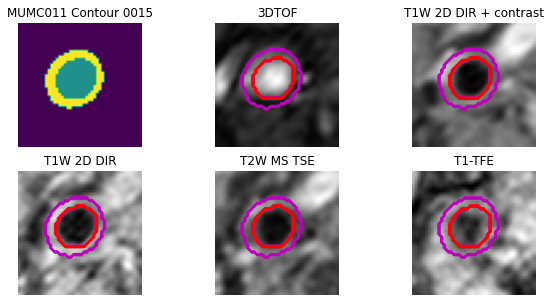

MUMC013 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


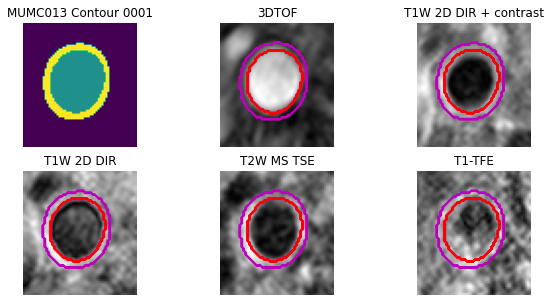

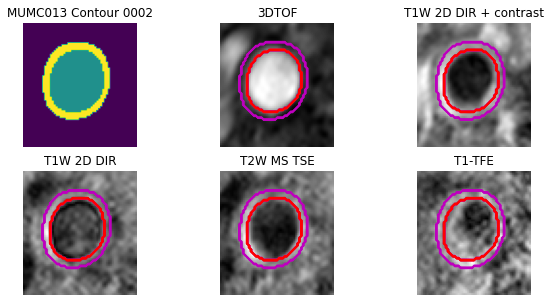

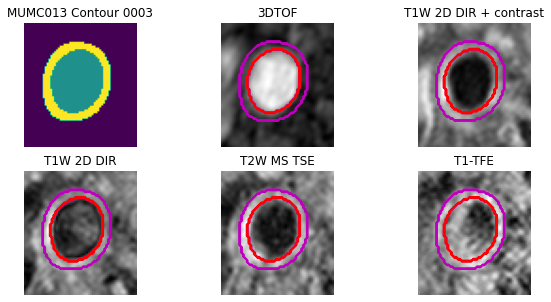

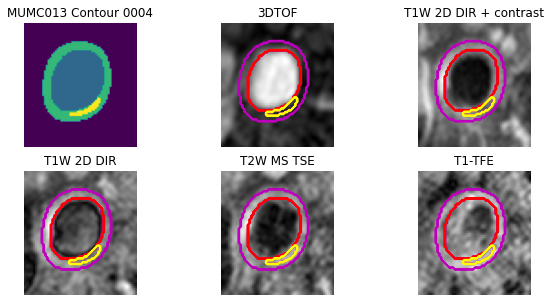

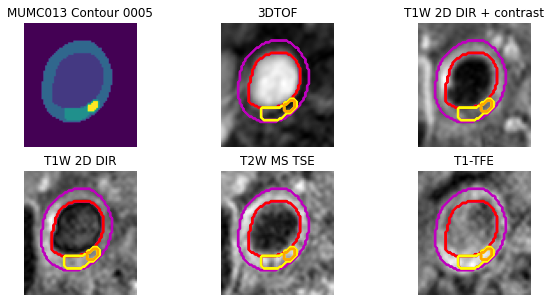

...

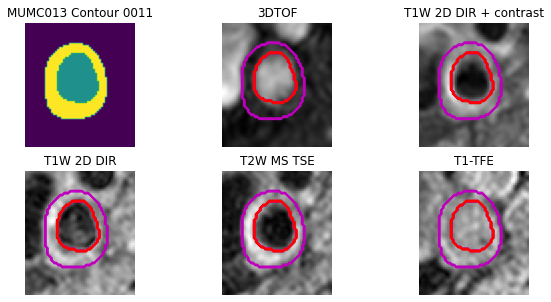

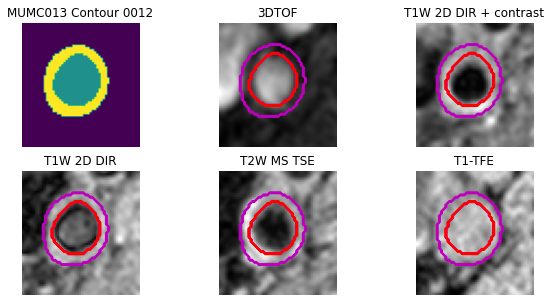

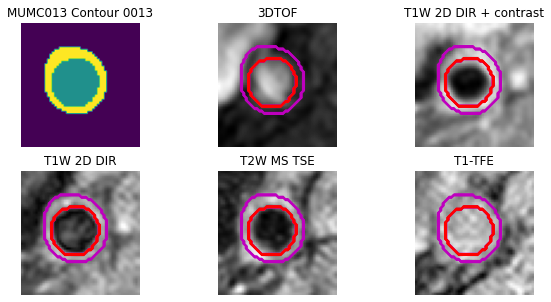

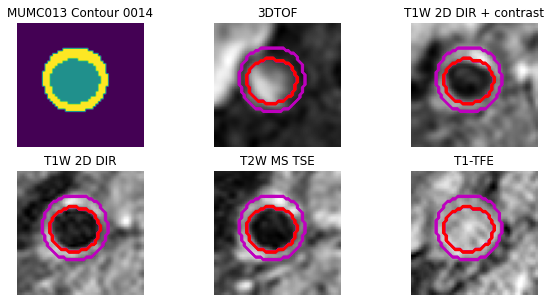

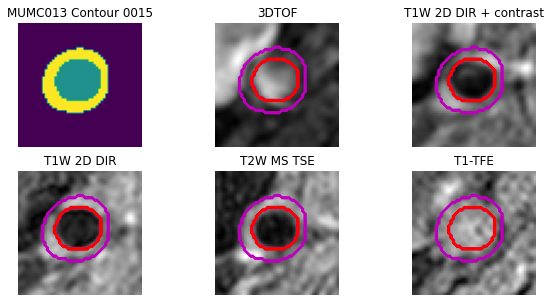

MUMC014 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


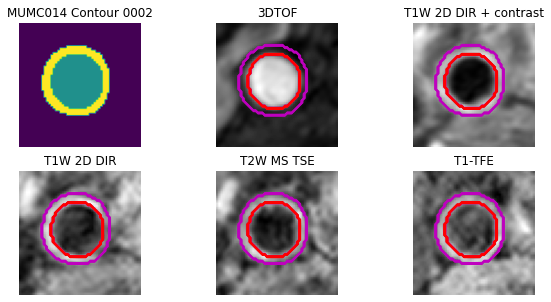

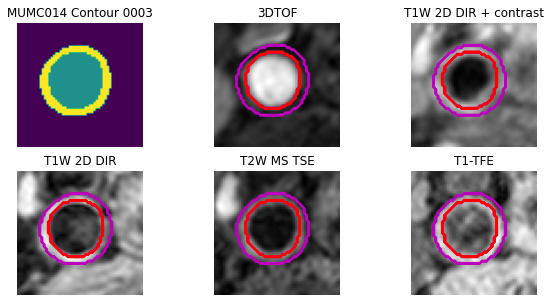

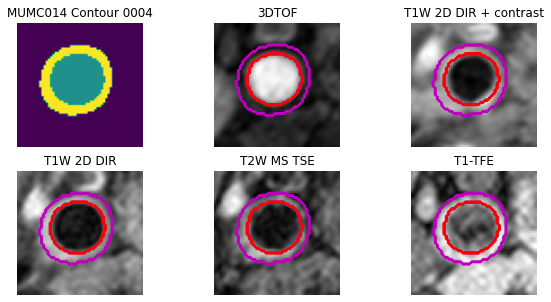

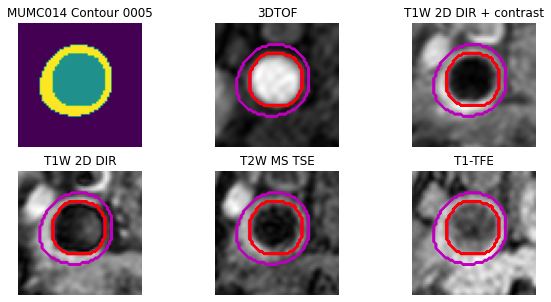

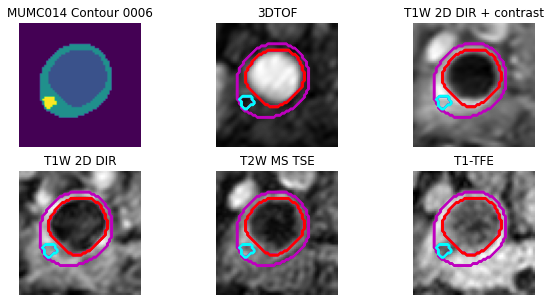

...

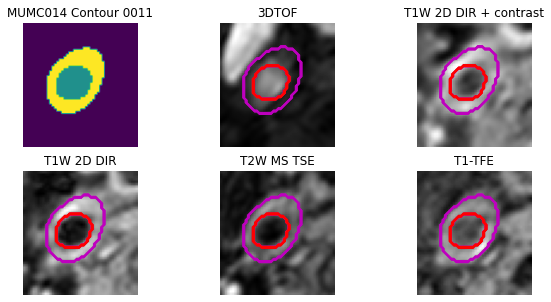

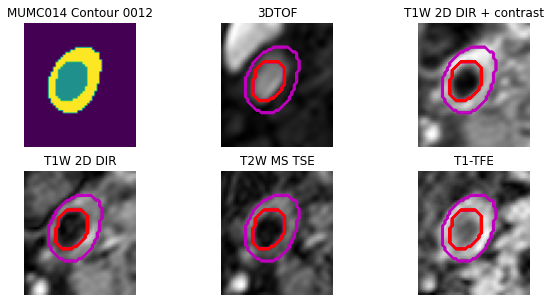

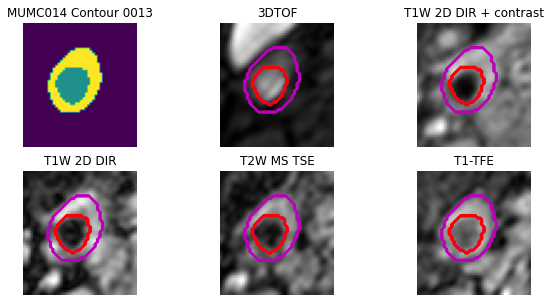

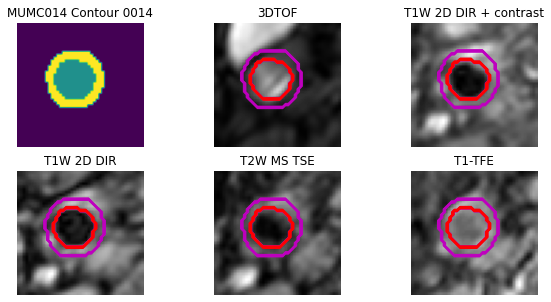

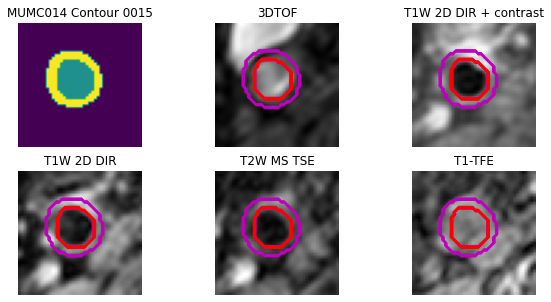

MUMC015 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


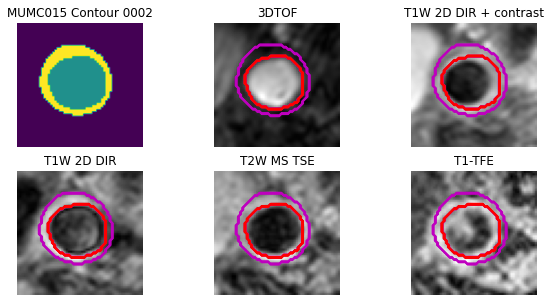

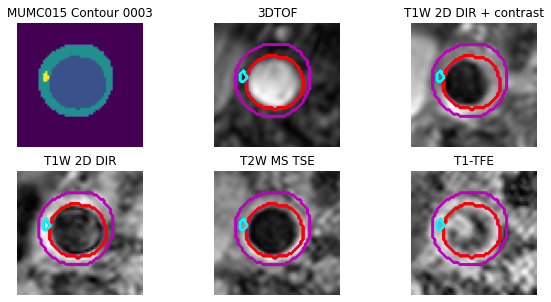

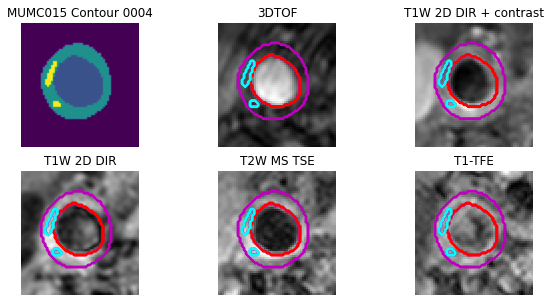

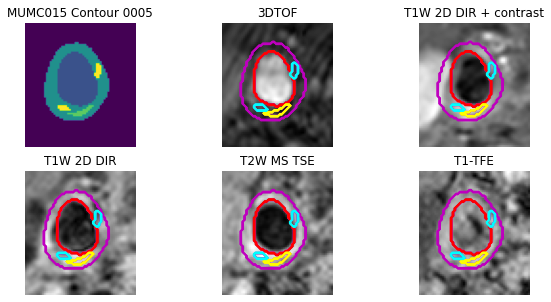

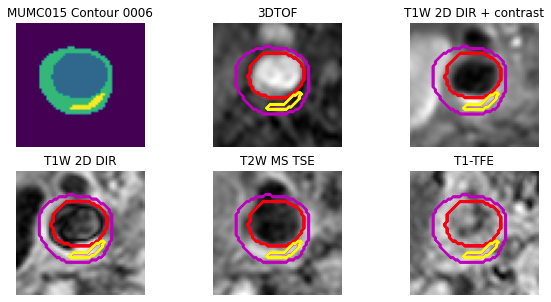

...

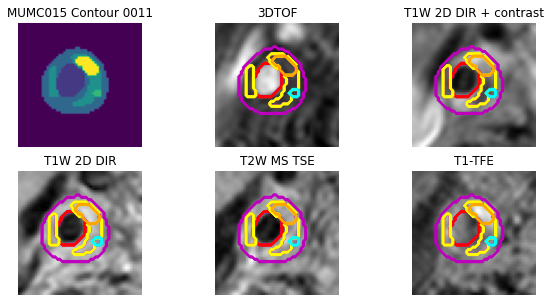

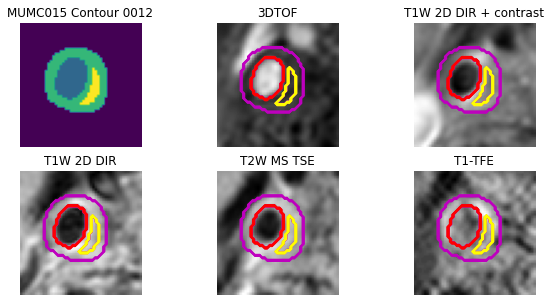

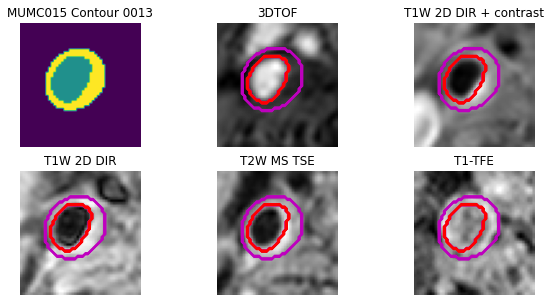

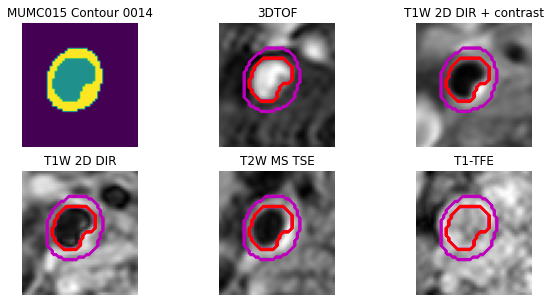

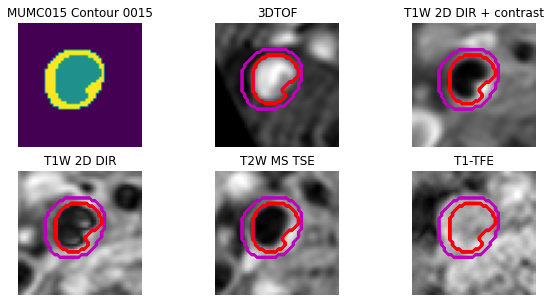

MUMC016 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


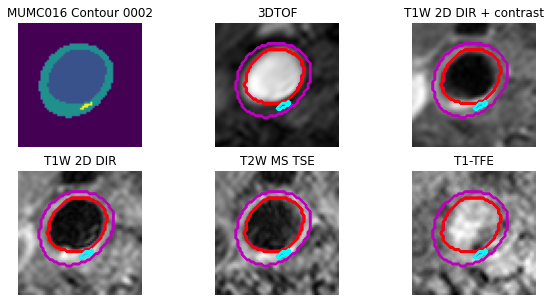

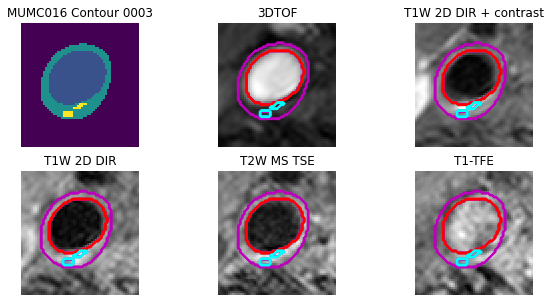

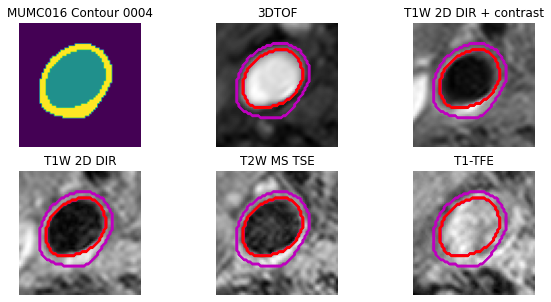

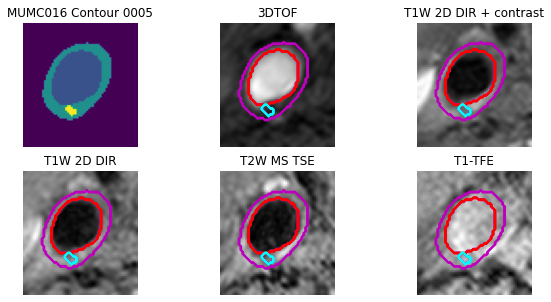

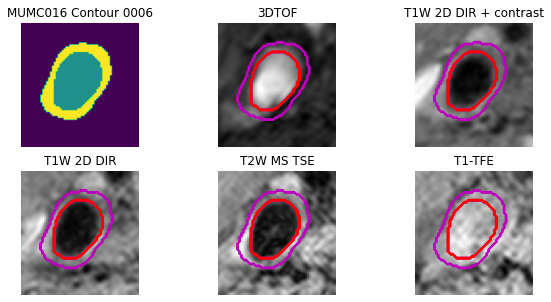

...

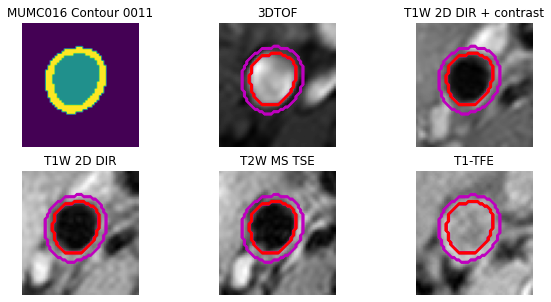

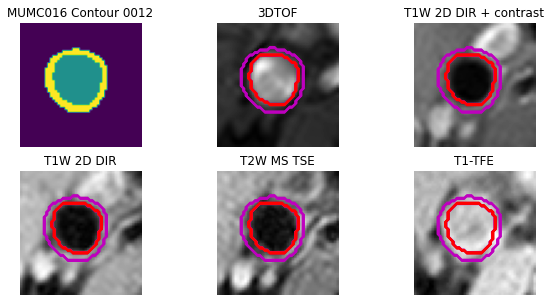

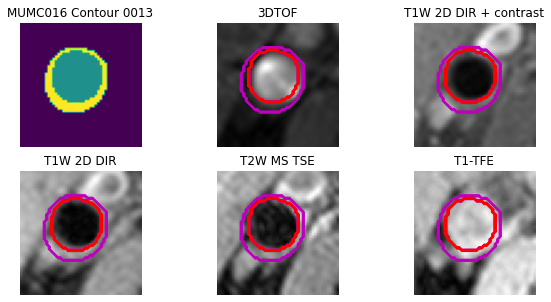

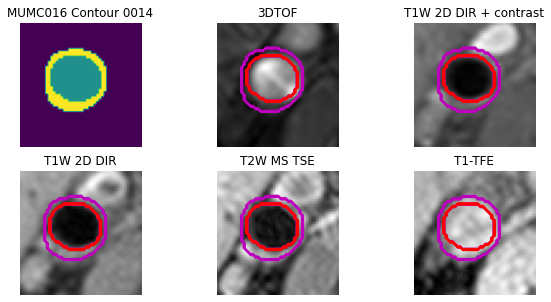

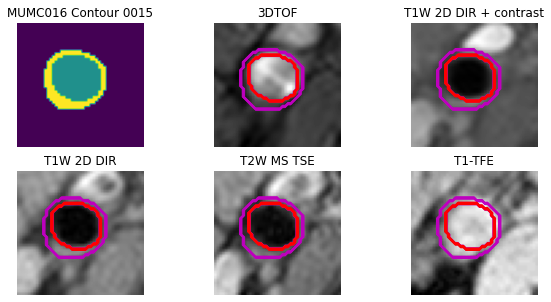

MUMC017 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


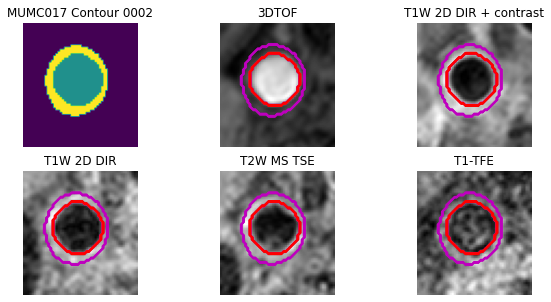

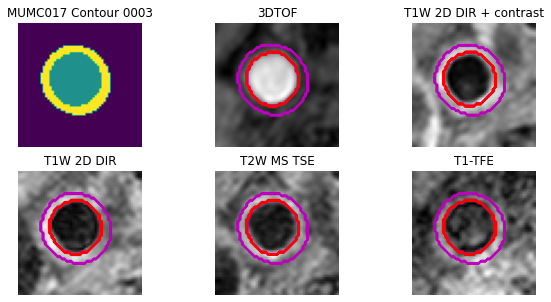

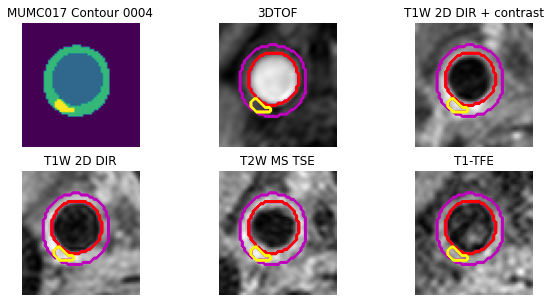

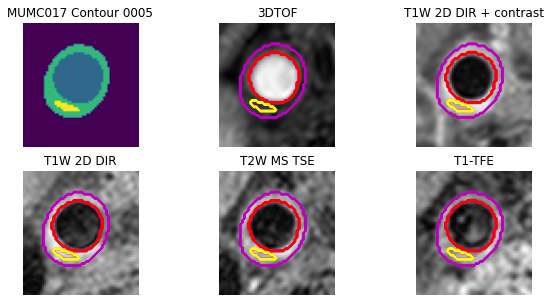

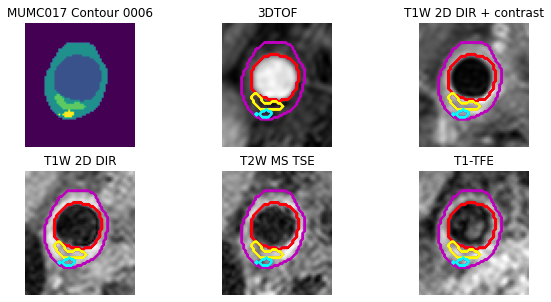

...

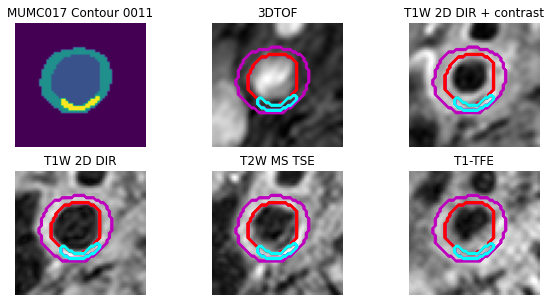

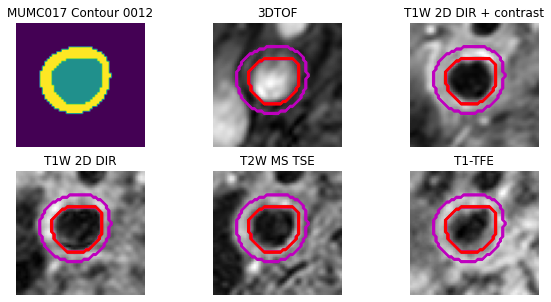

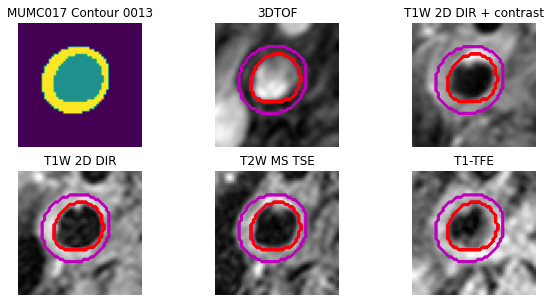

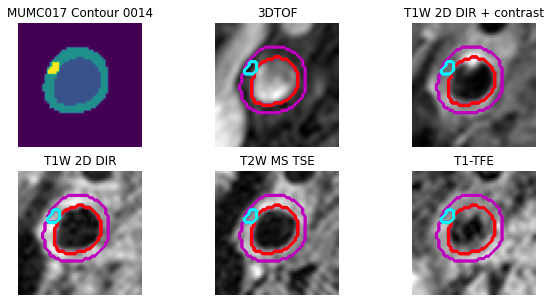

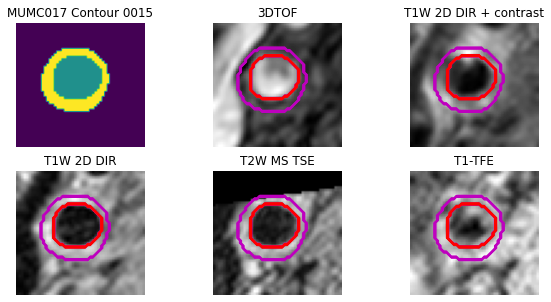

MUMC019 [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


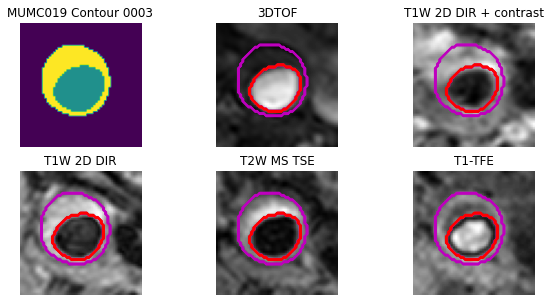

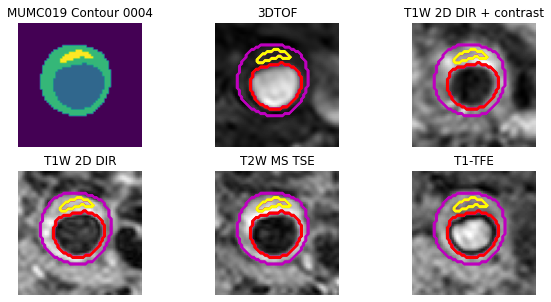

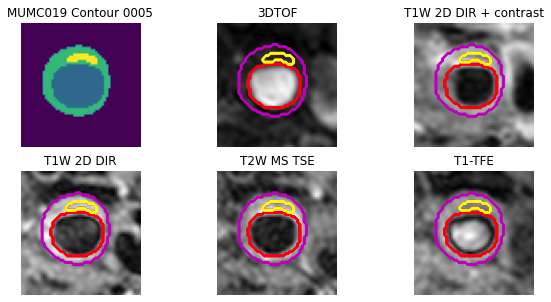

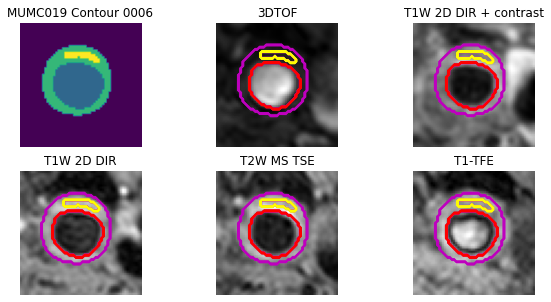

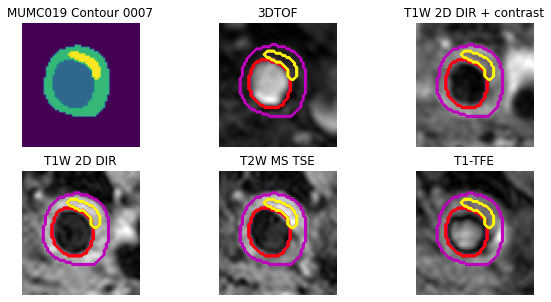

...

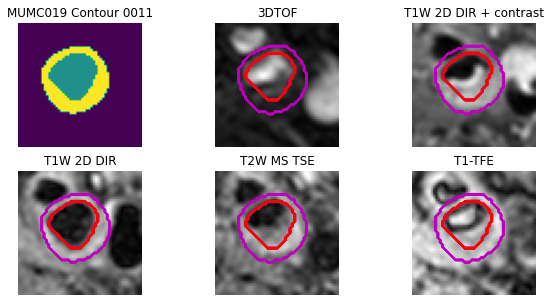

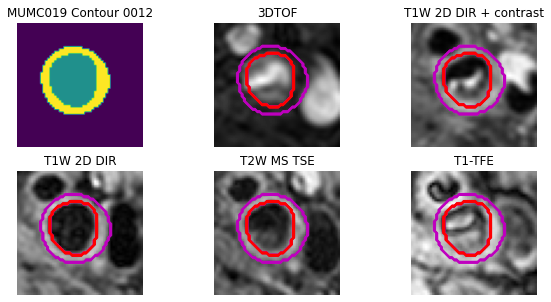

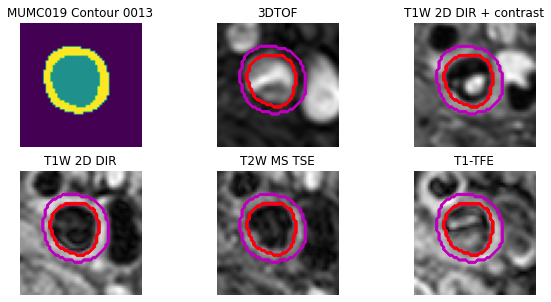

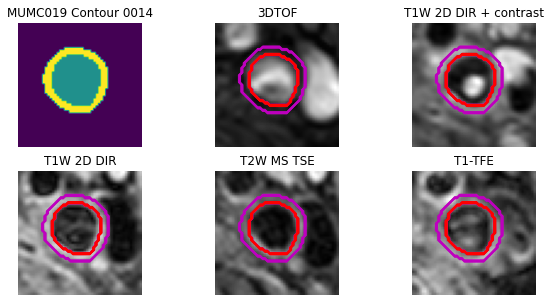

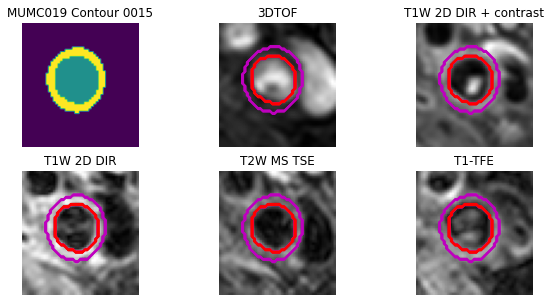

MUMC020 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


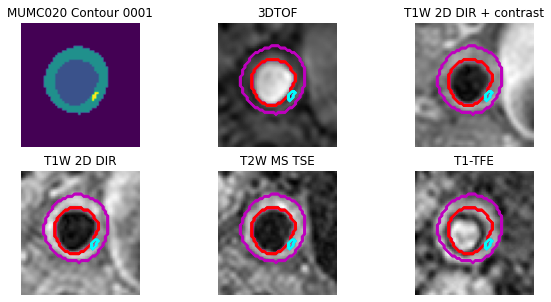

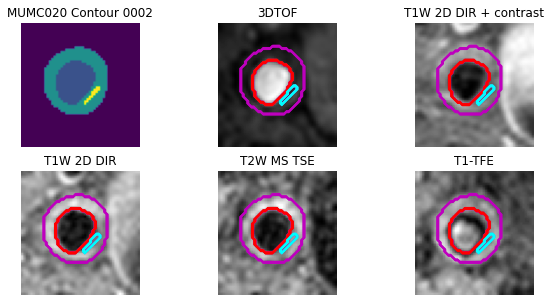

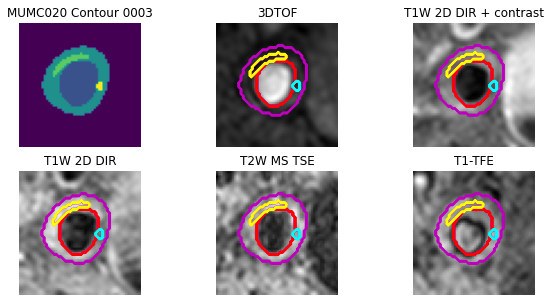

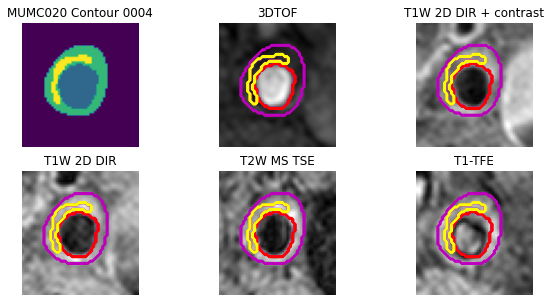

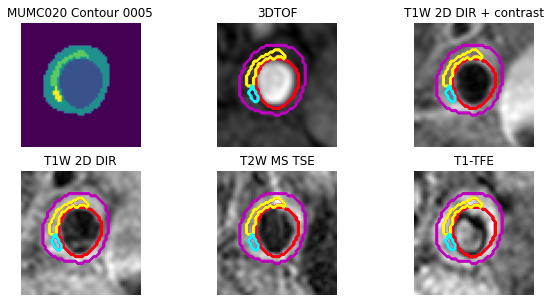

...

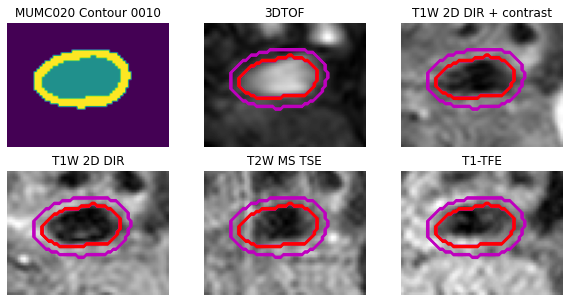

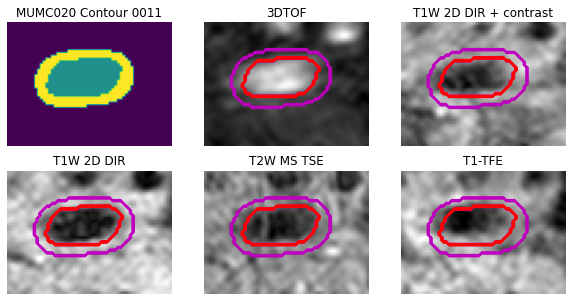

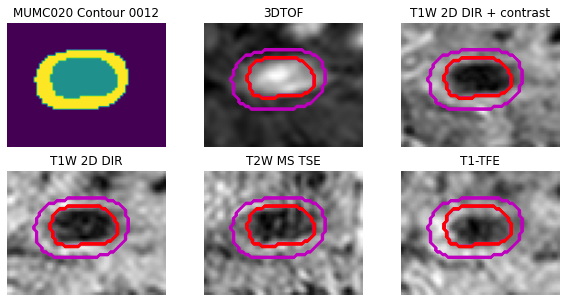

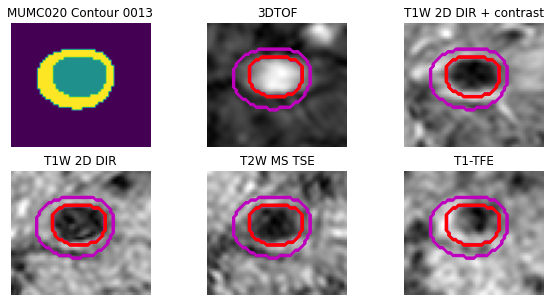

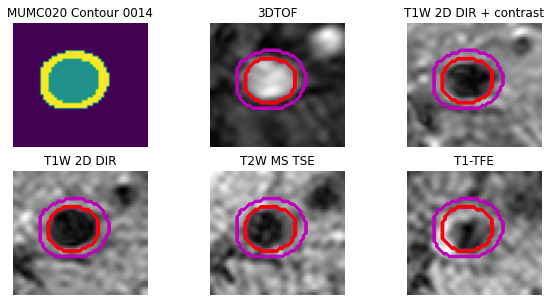

MUMC021 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


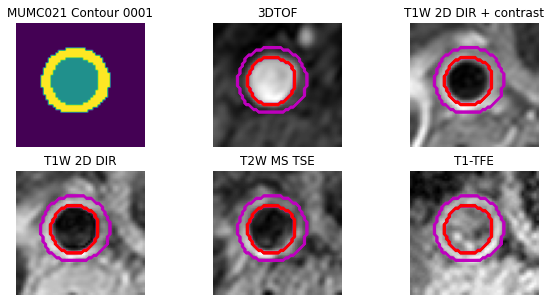

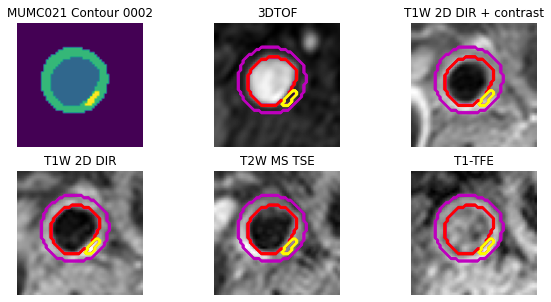

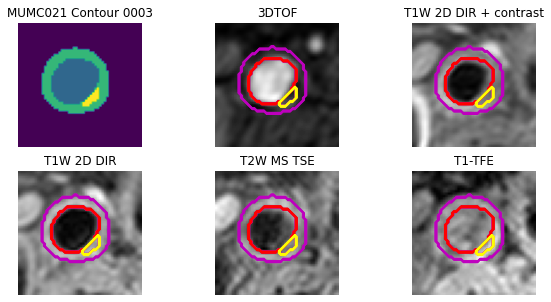

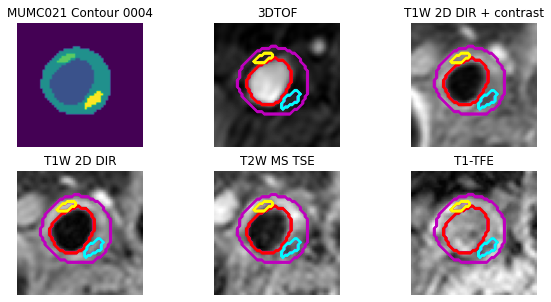

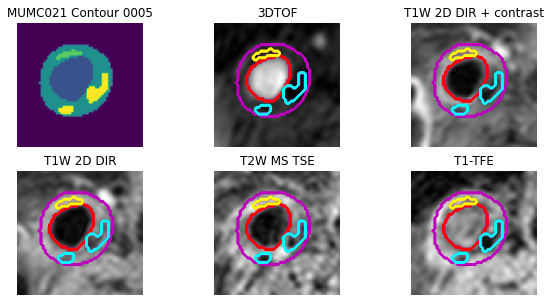

...

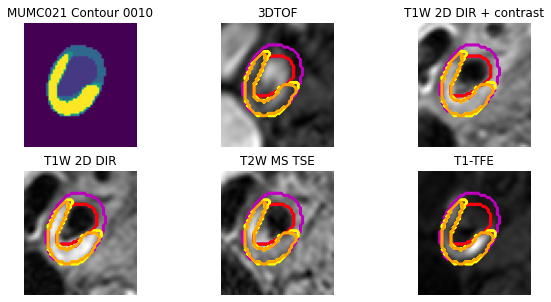

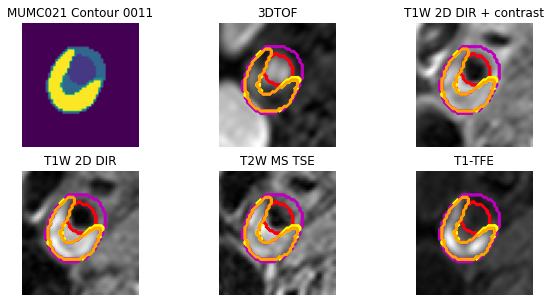

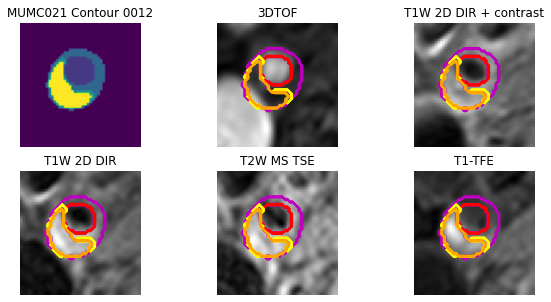

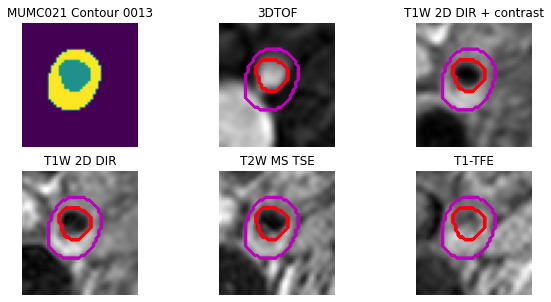

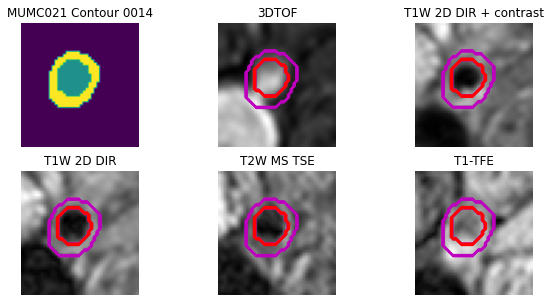

MUMC022 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


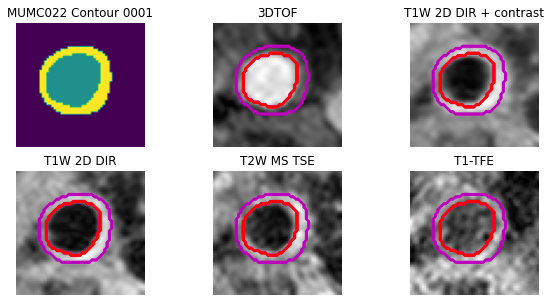

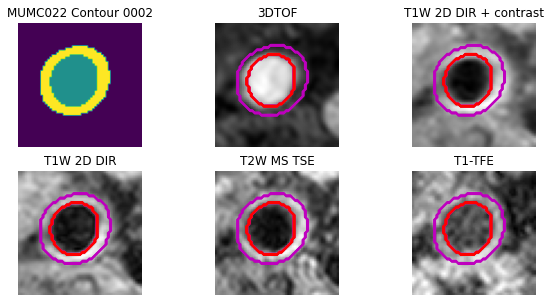

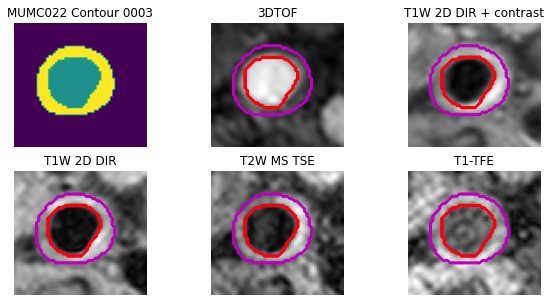

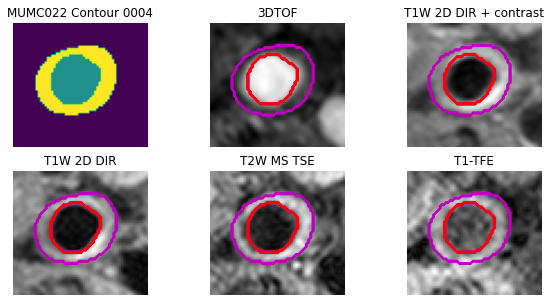

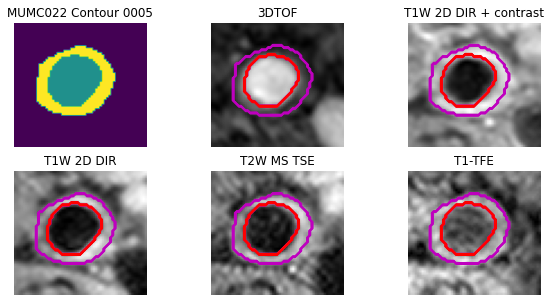

...

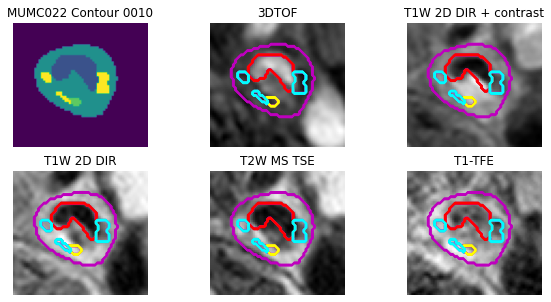

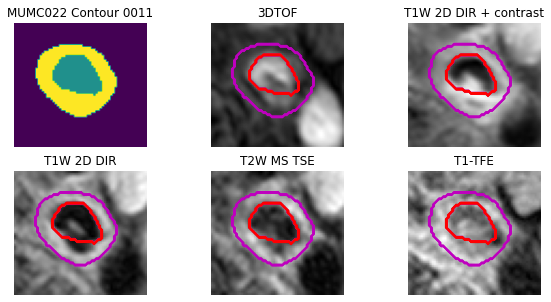

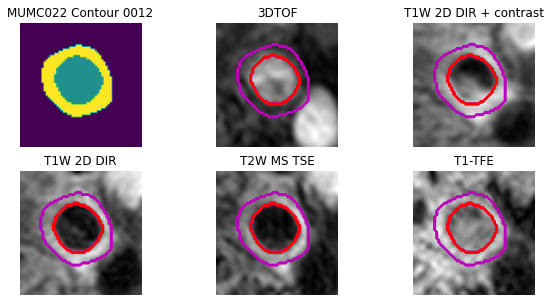

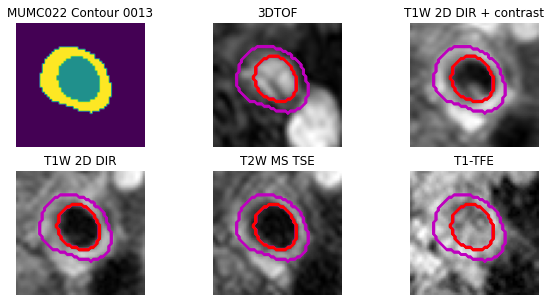

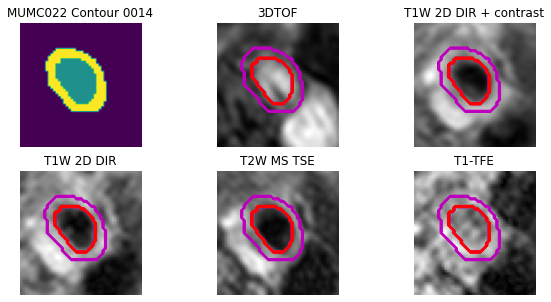

MUMC024 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


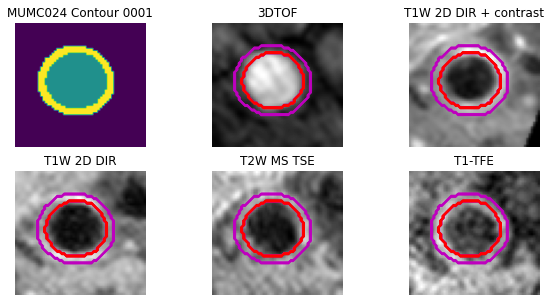

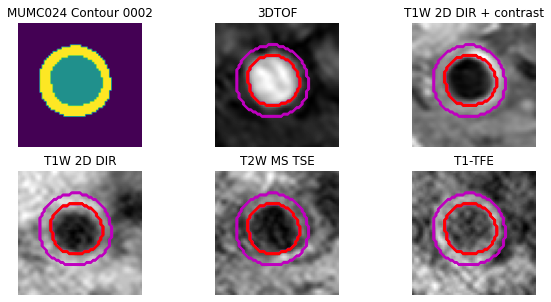

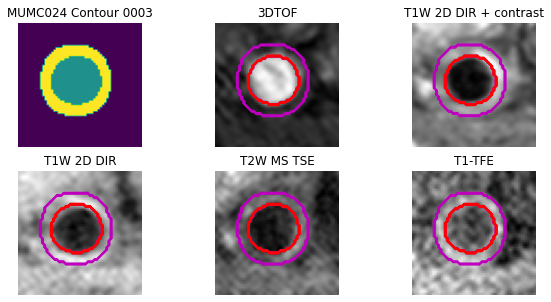

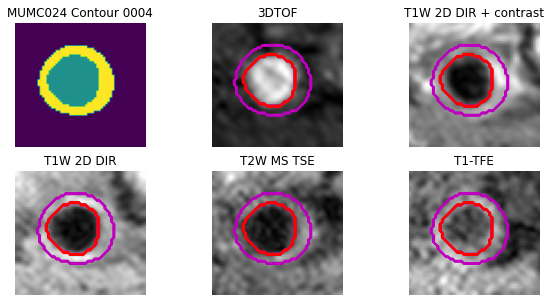

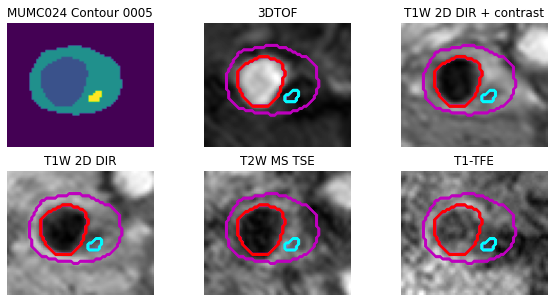

...

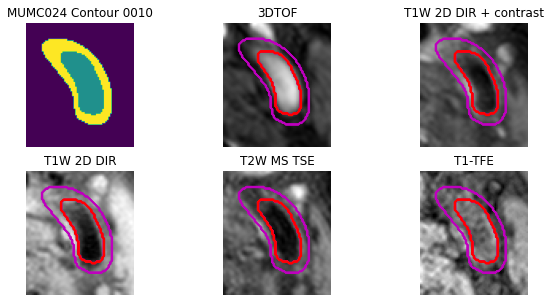

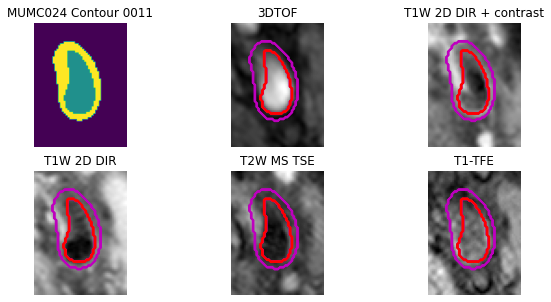

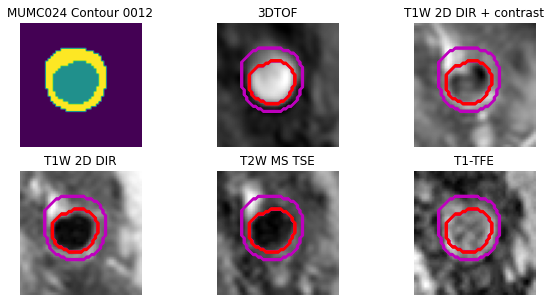

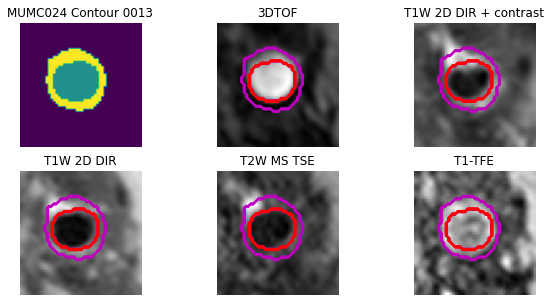

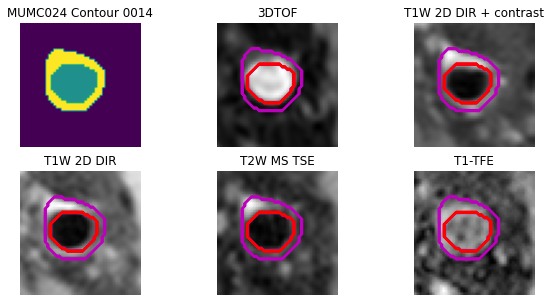

MUMC025 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


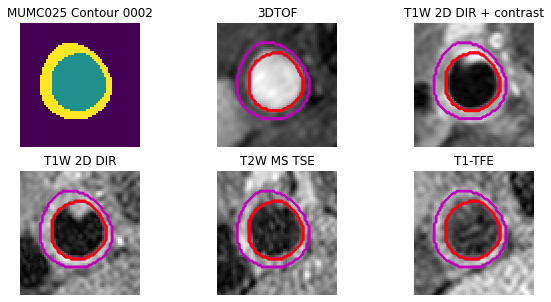

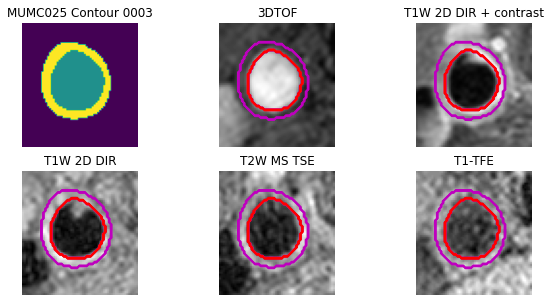

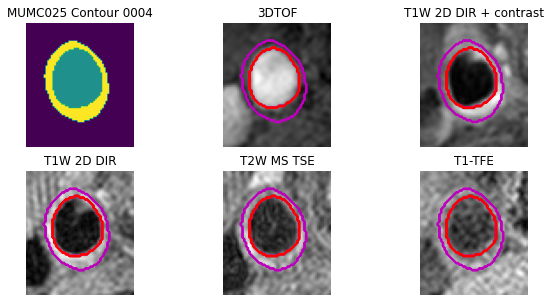

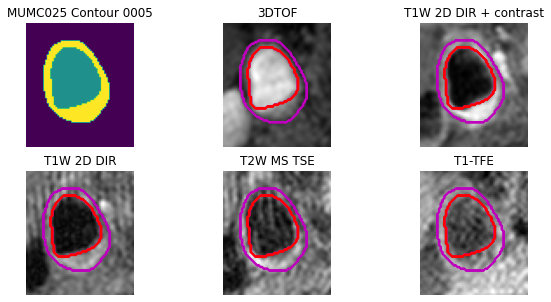

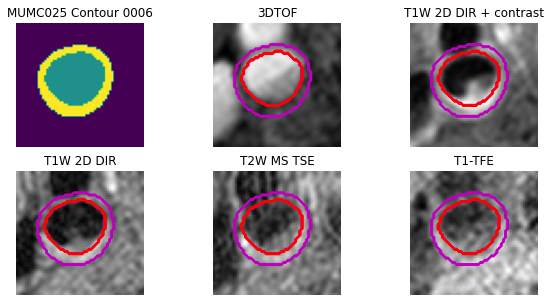

...

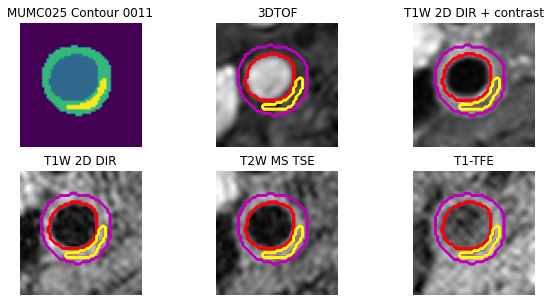

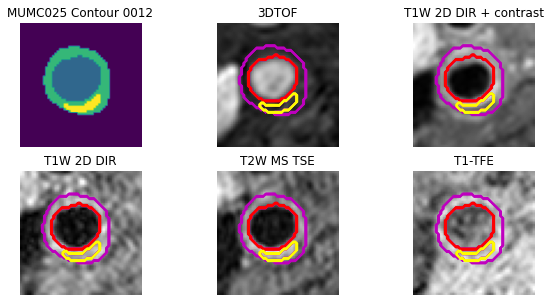

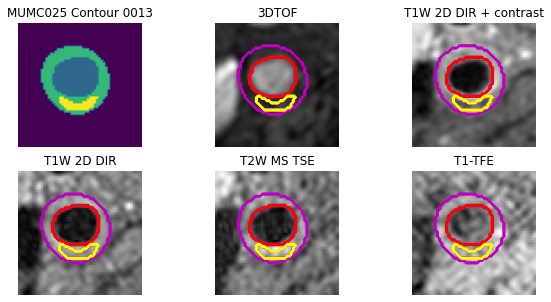

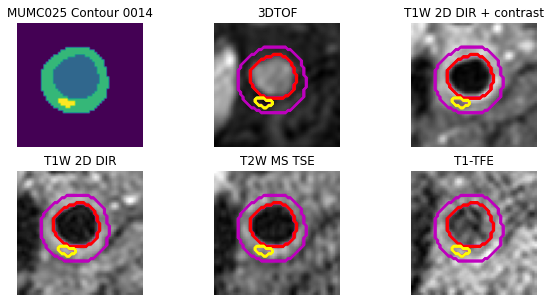

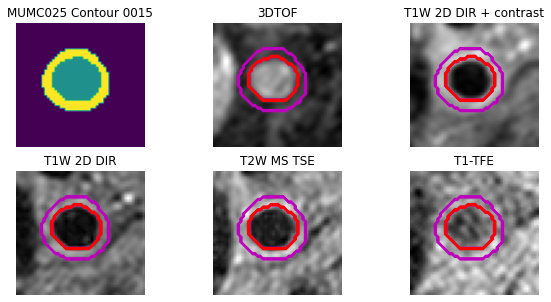

MUMC026 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


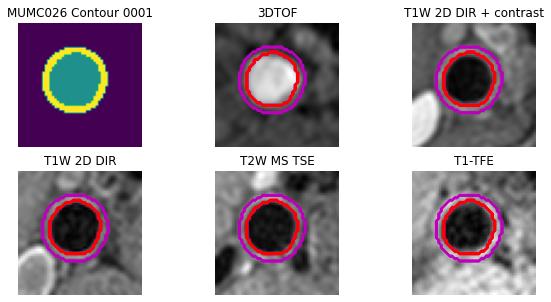

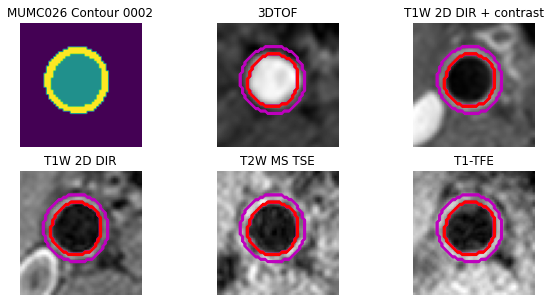

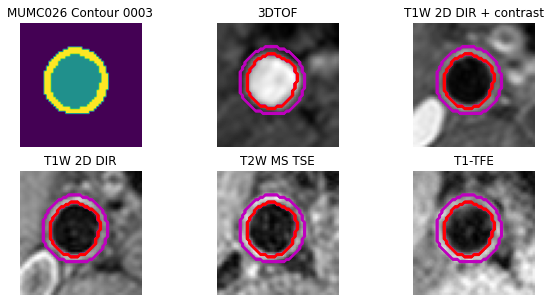

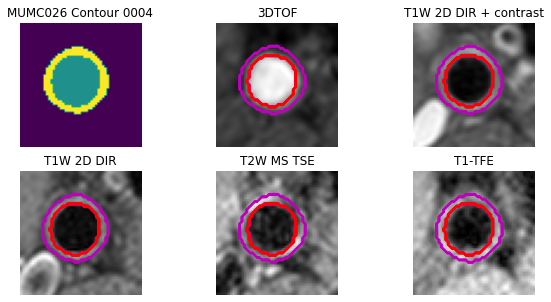

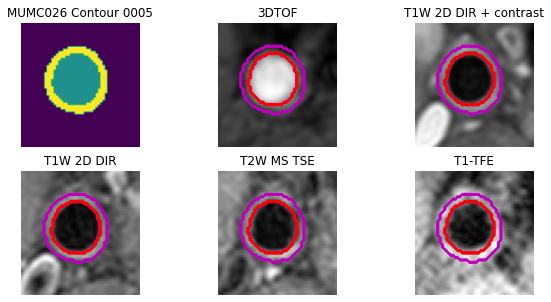

...

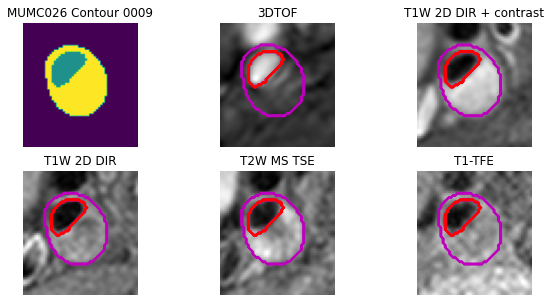

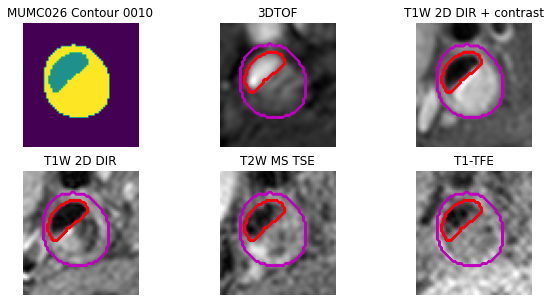

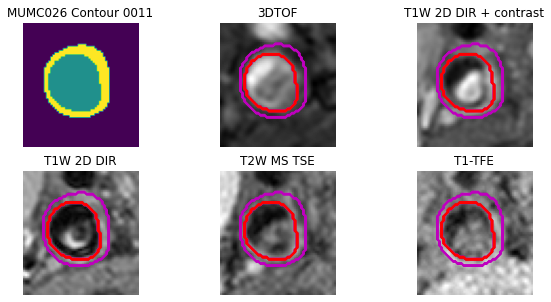

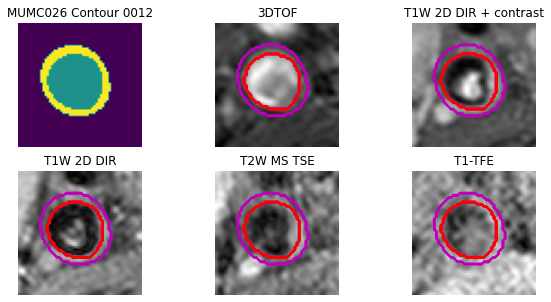

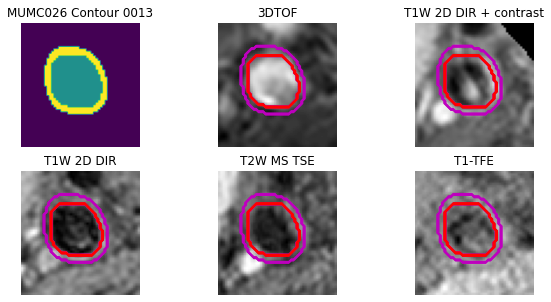

MUMC027 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


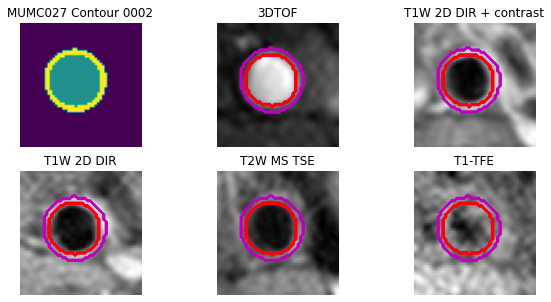

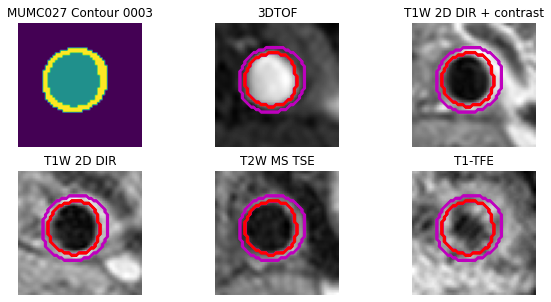

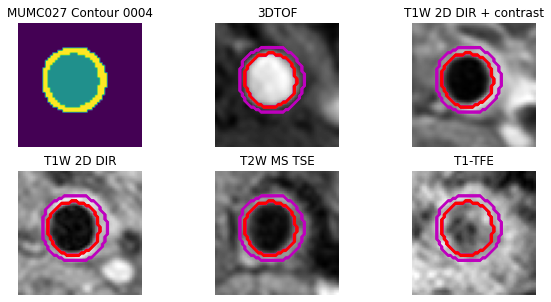

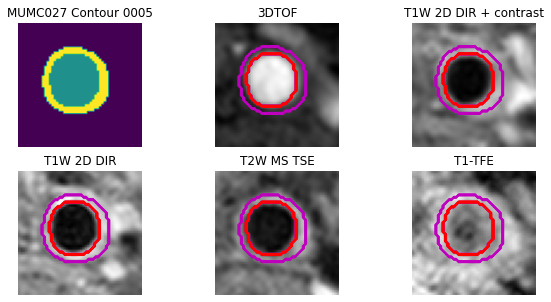

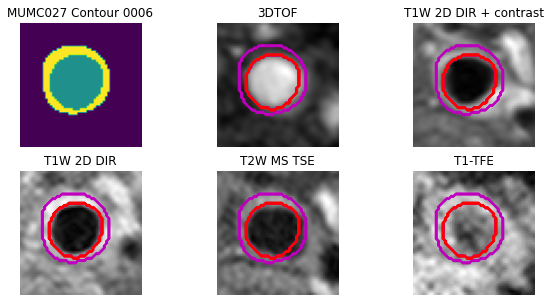

...

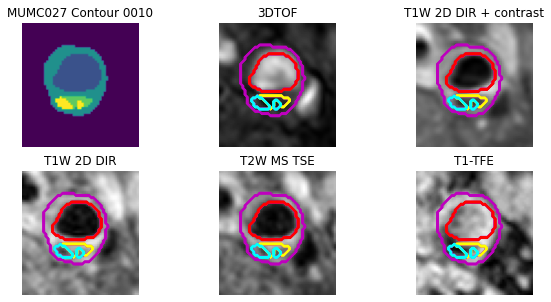

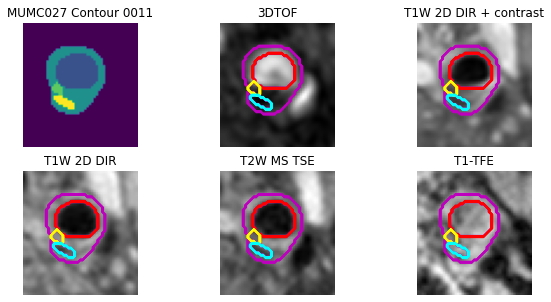

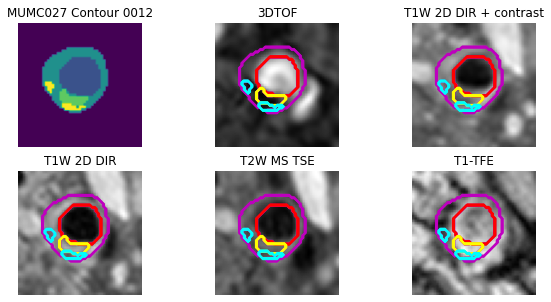

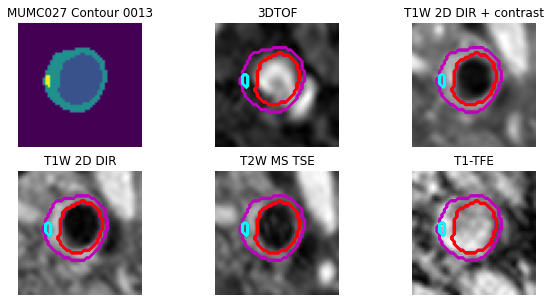

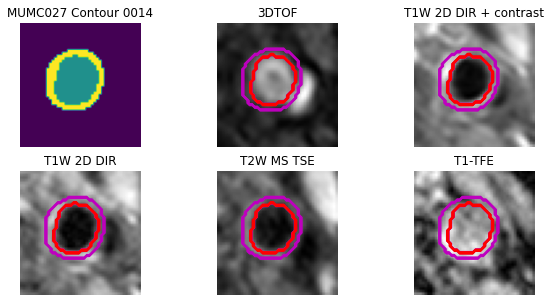

MUMC028 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


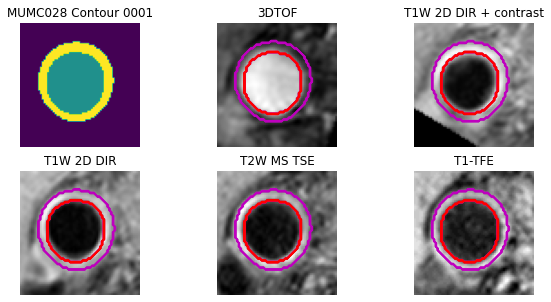

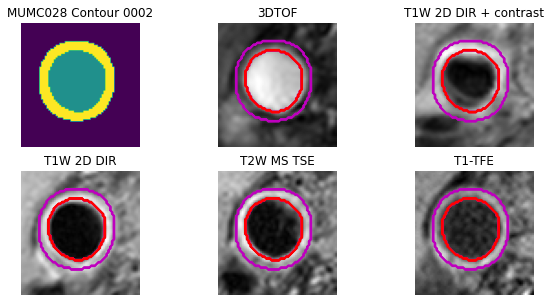

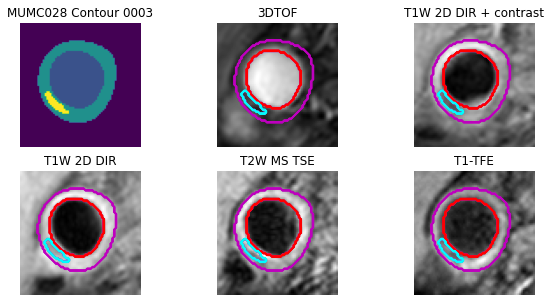

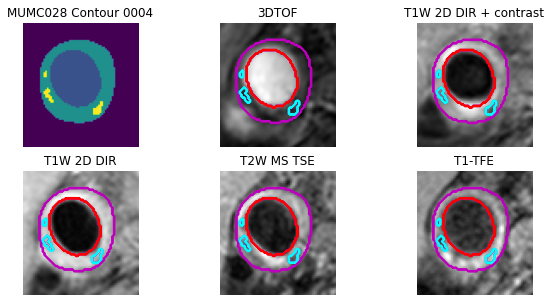

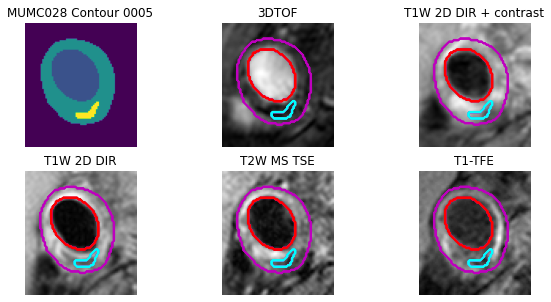

...

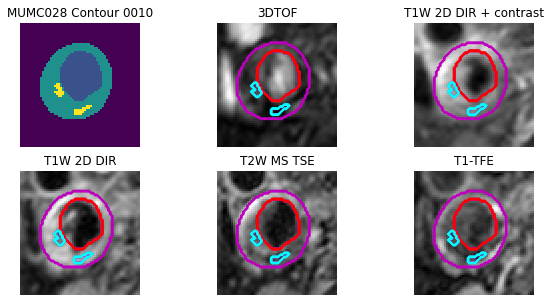

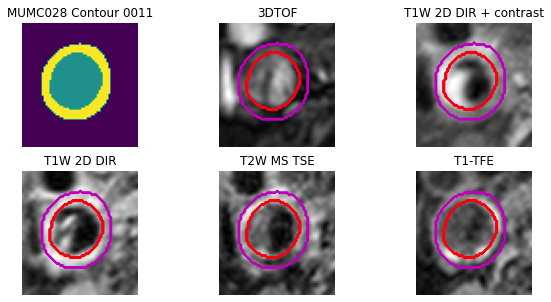

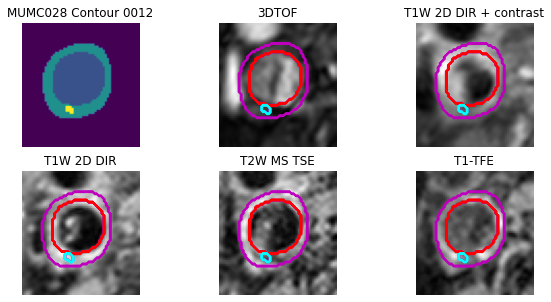

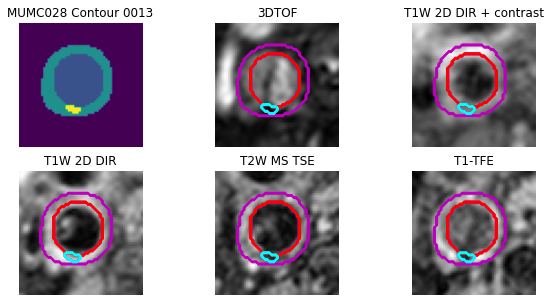

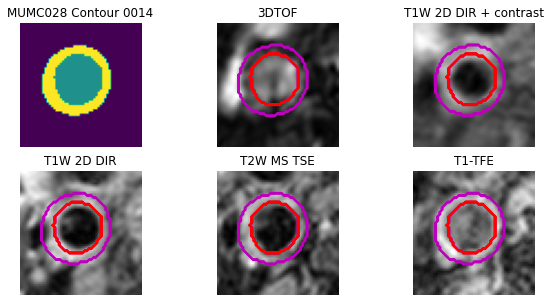

MUMC029 [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


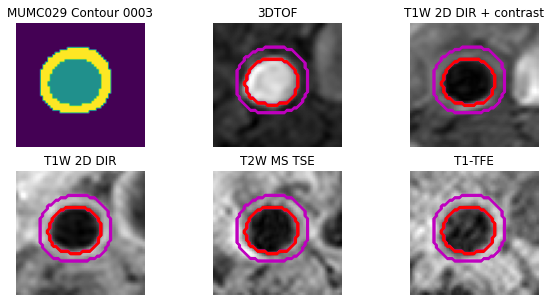

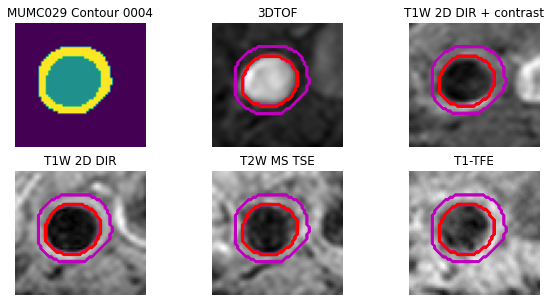

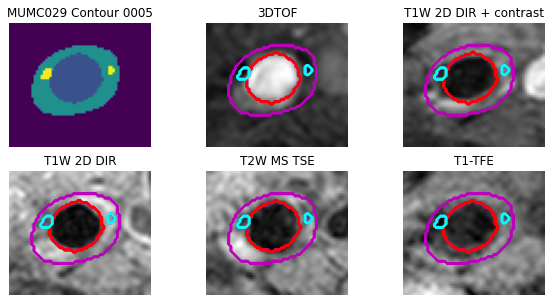

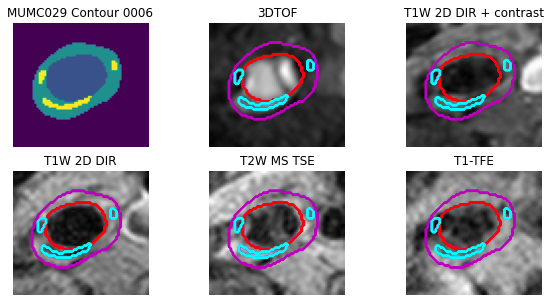

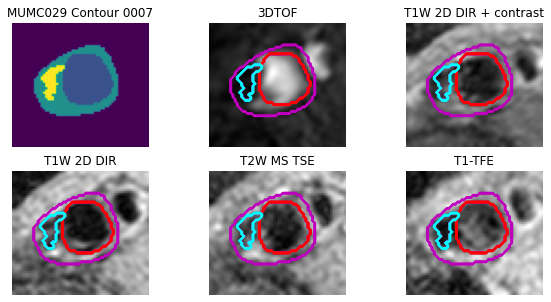

...

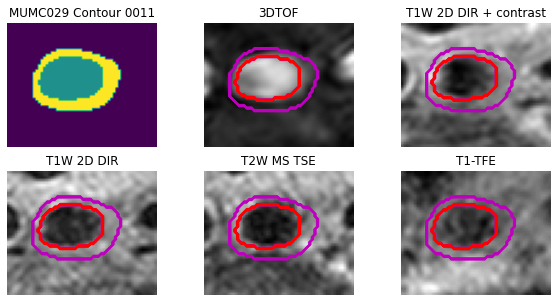

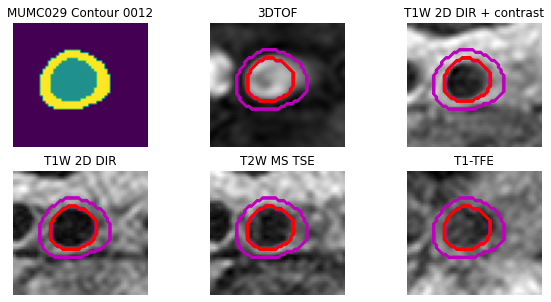

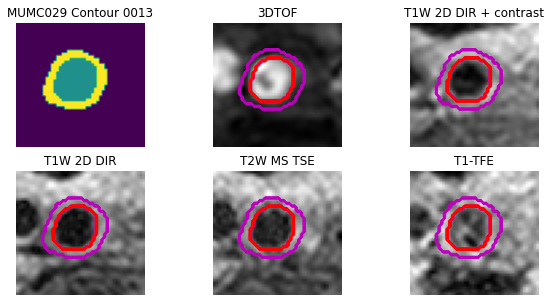

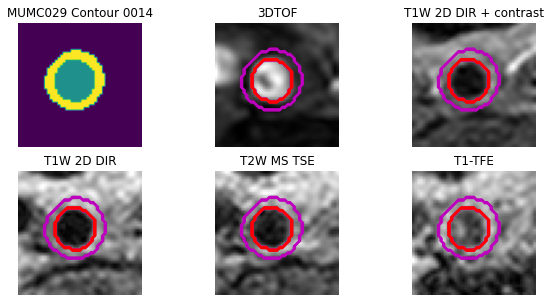

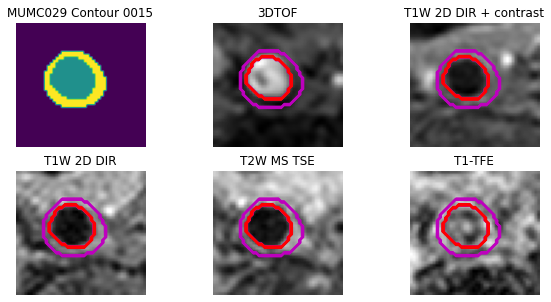

MUMC030 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


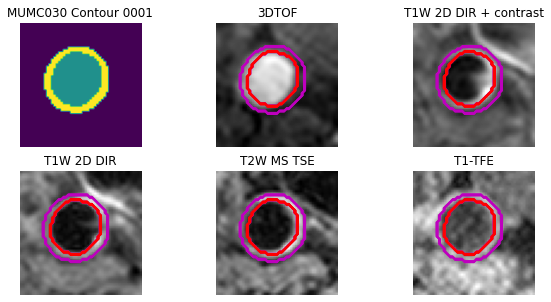

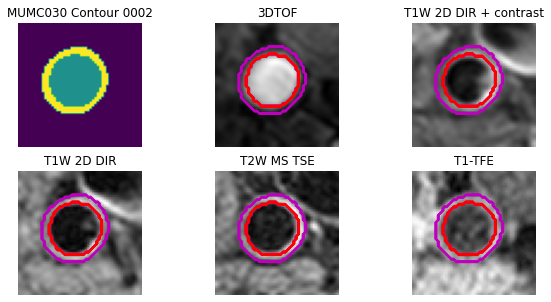

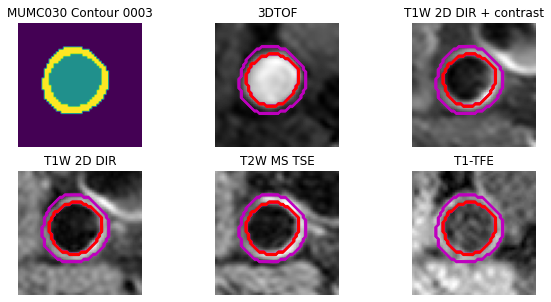

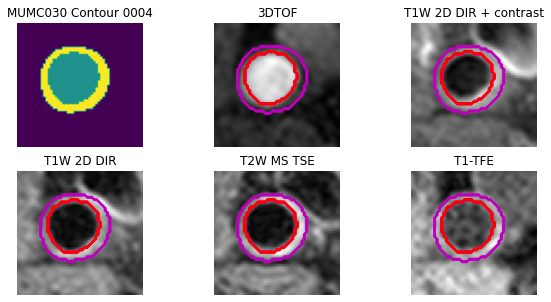

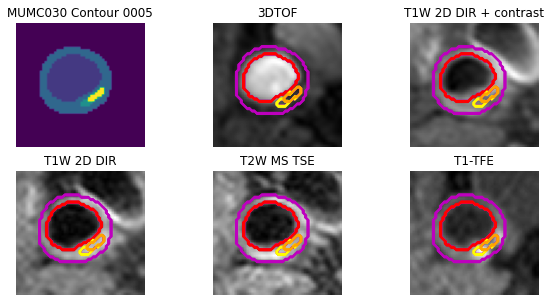

...

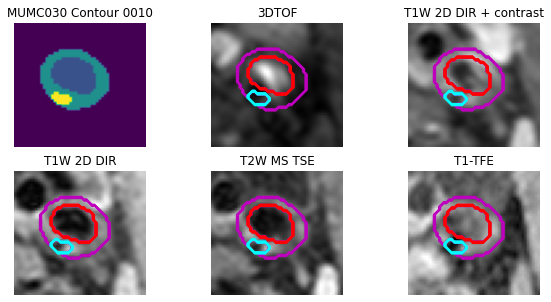

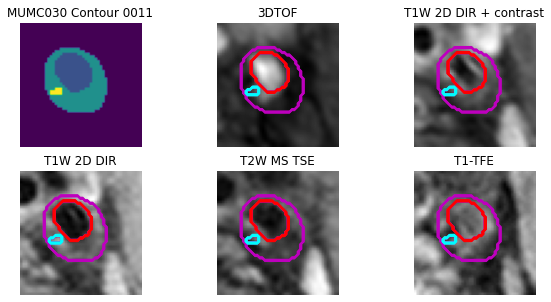

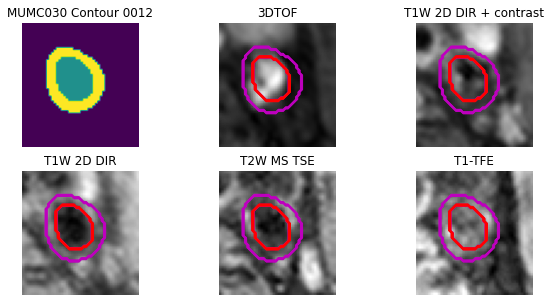

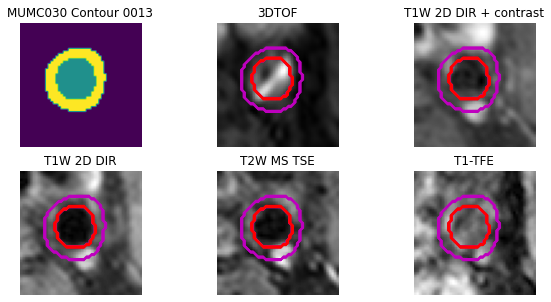

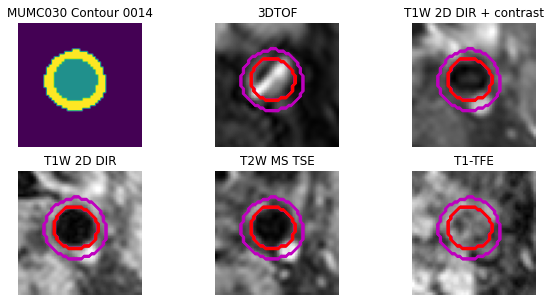

MUMC031 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


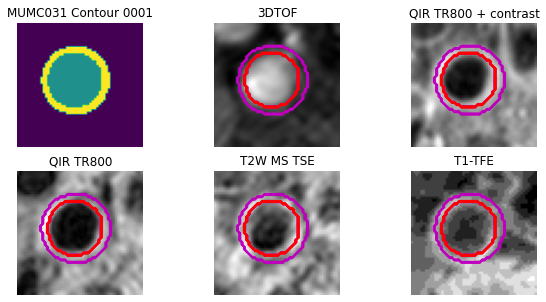

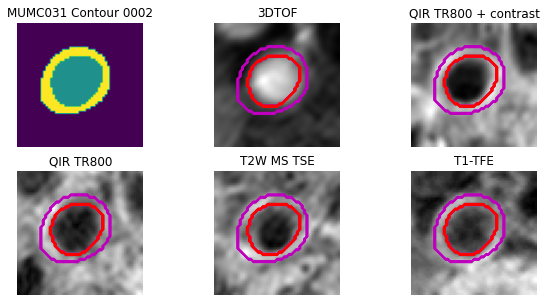

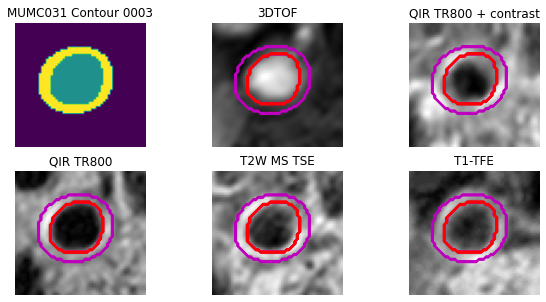

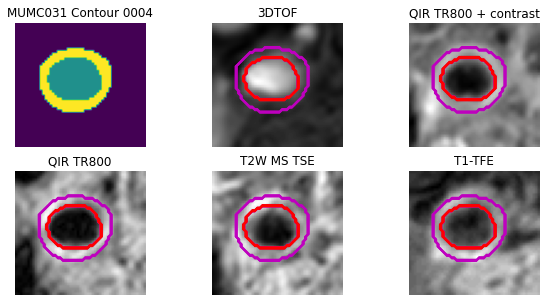

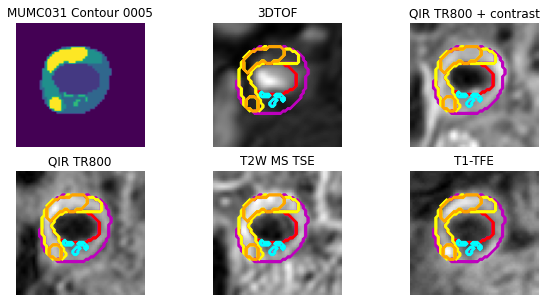

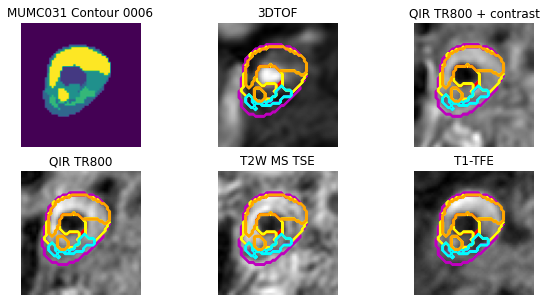

c:\users\e.lavrova\.conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:44: UserWarning: No contour levels were found within the data range.


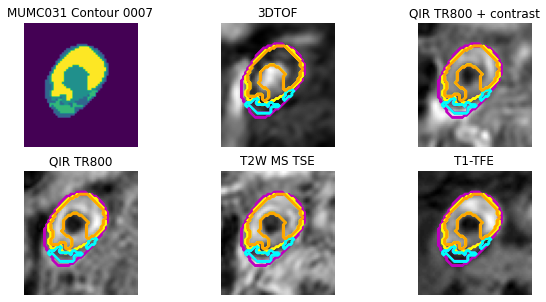

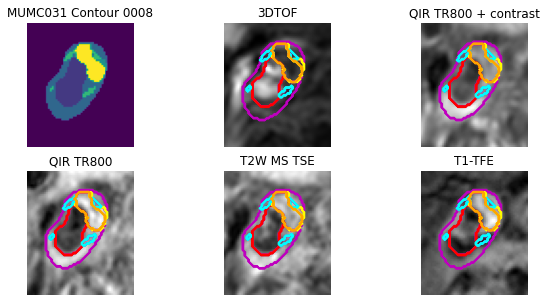

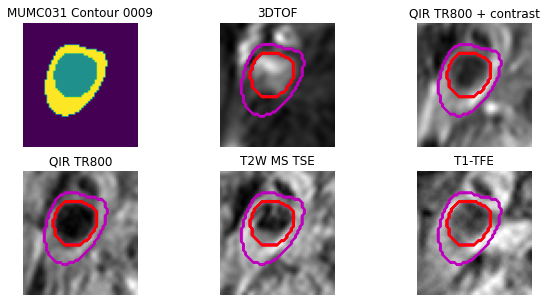

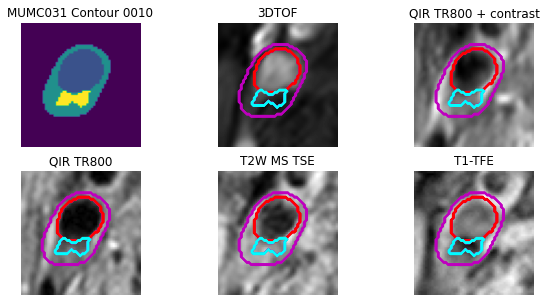

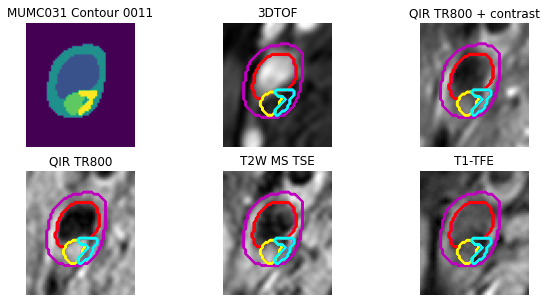

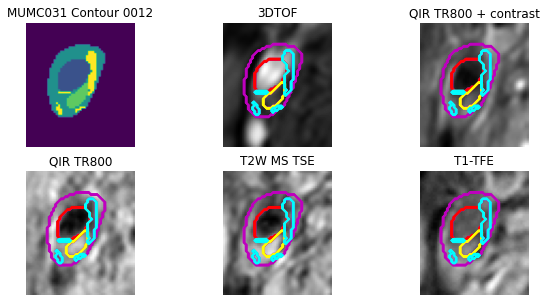

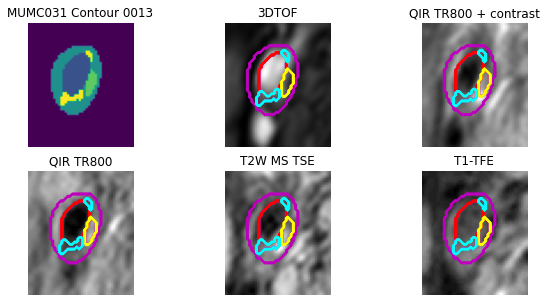

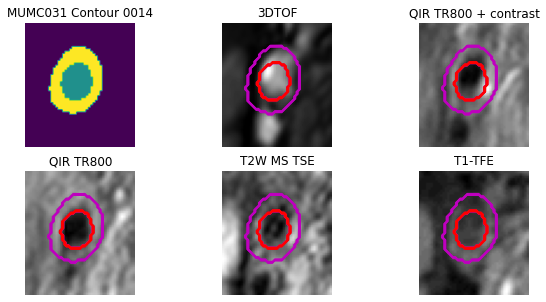

MUMC032 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


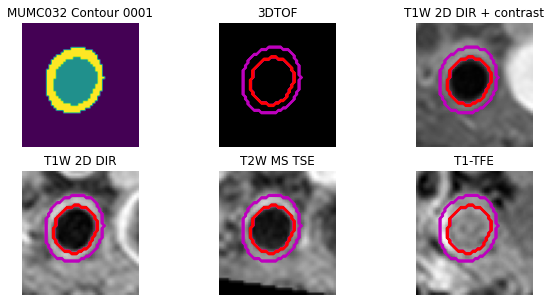

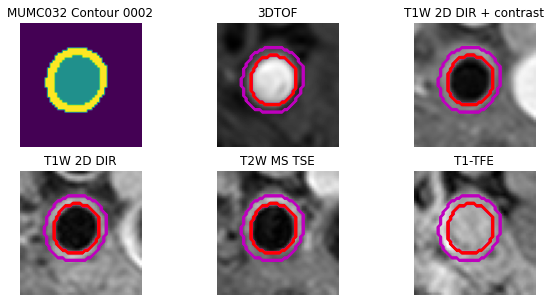

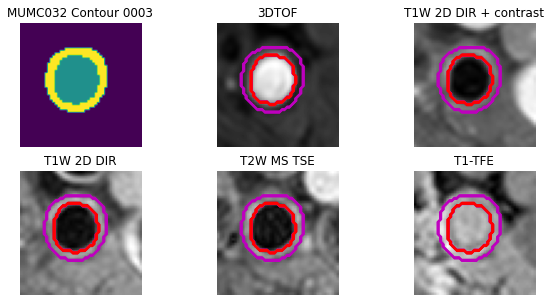

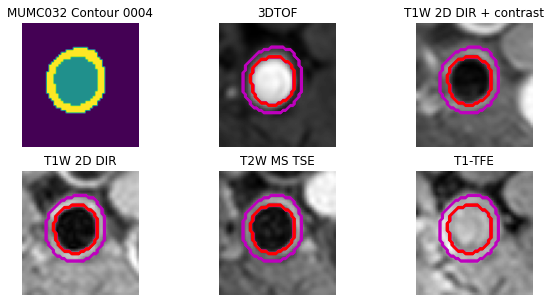

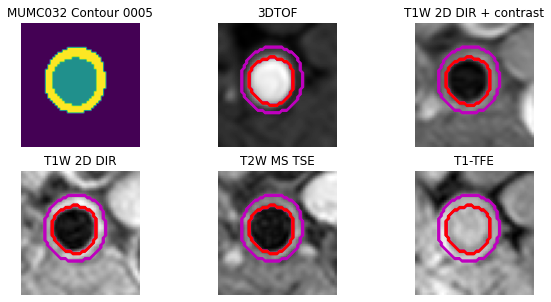

...

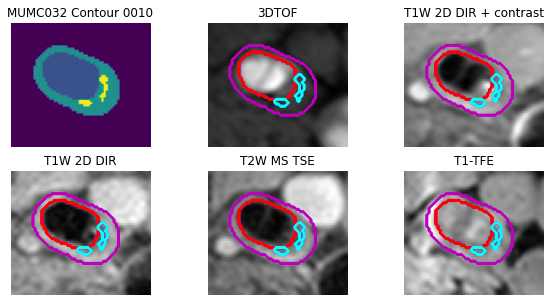

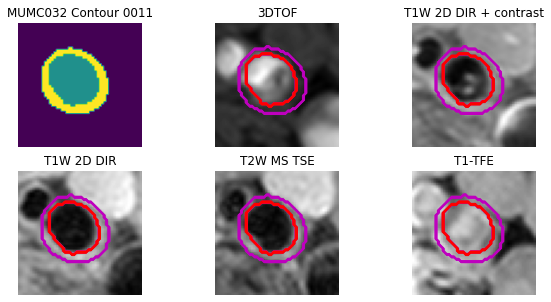

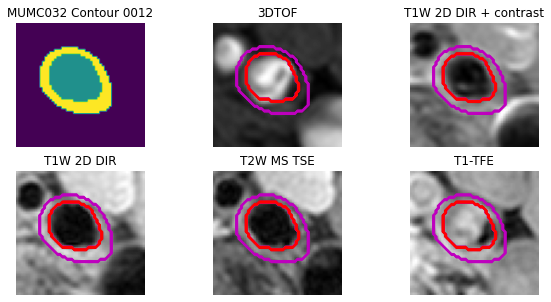

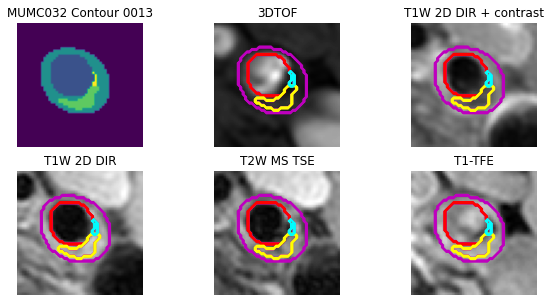

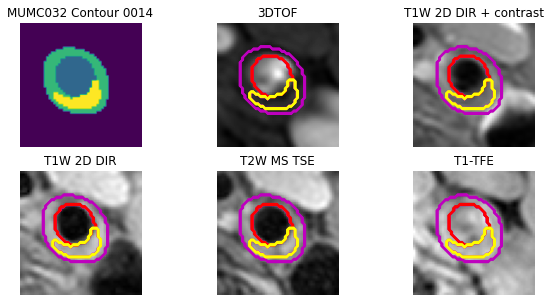

MUMC035 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


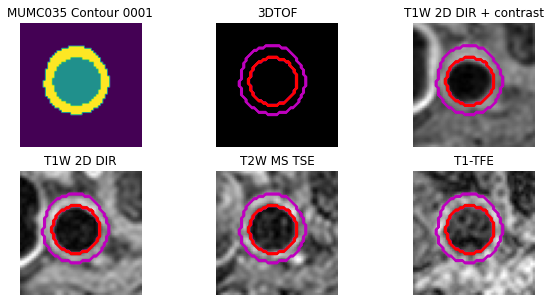

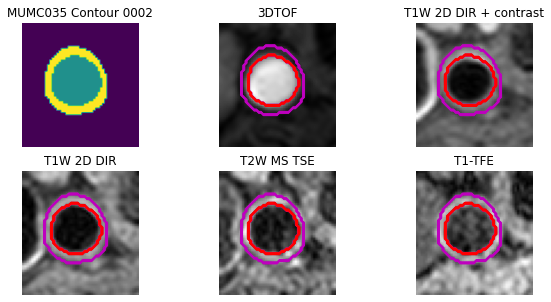

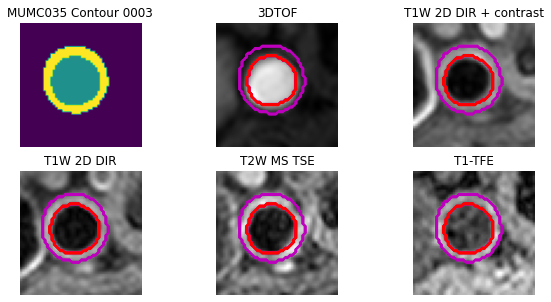

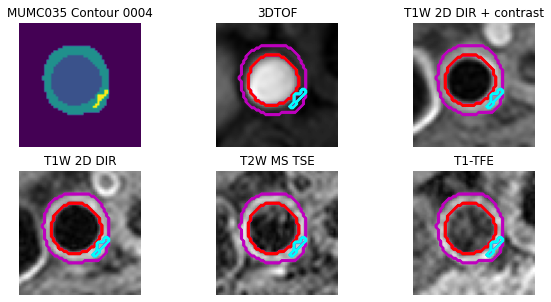

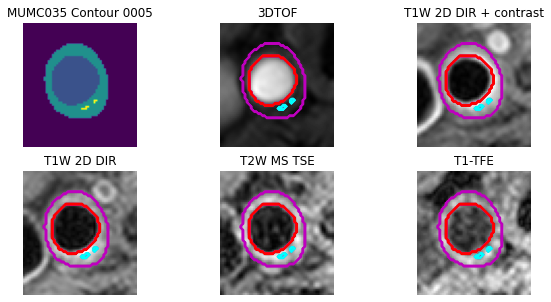

...

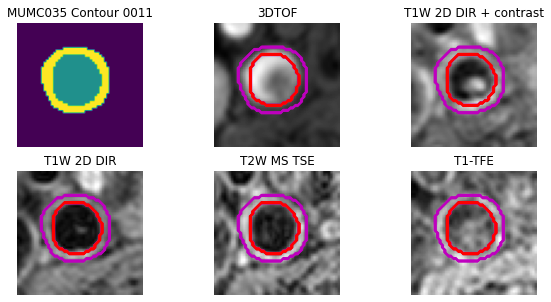

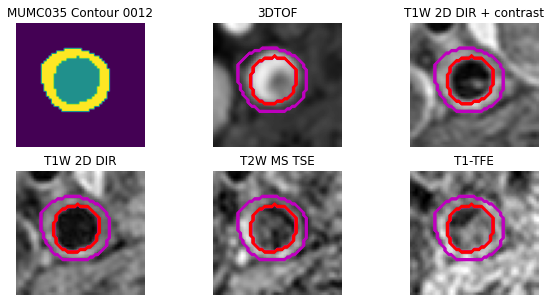

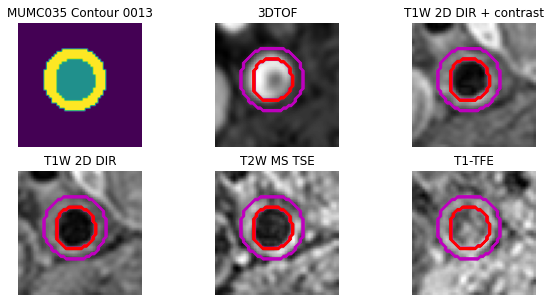

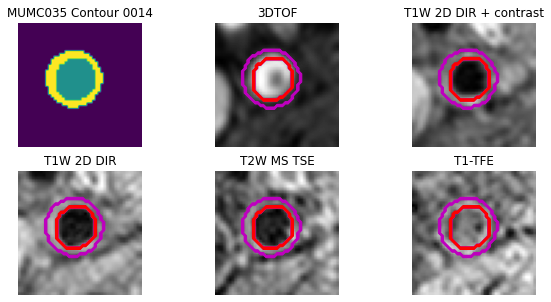

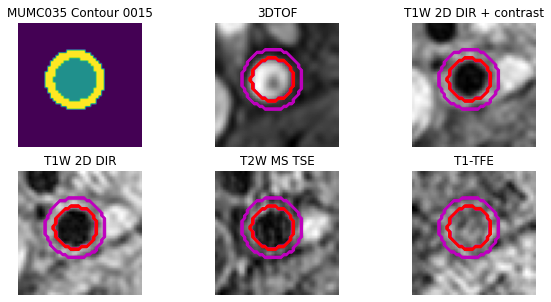

MUMC041 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


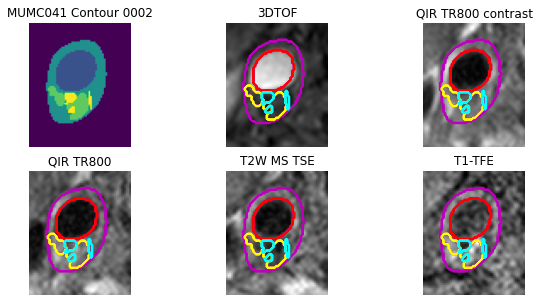

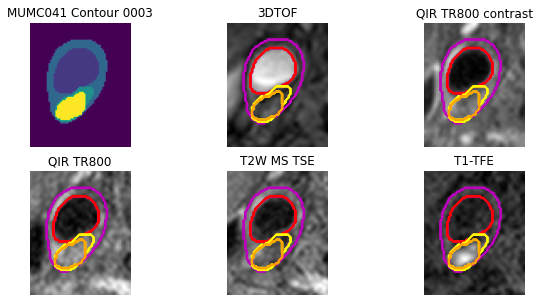

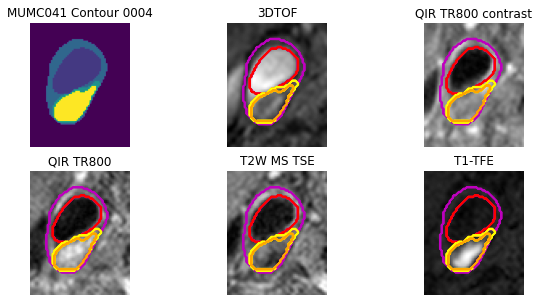

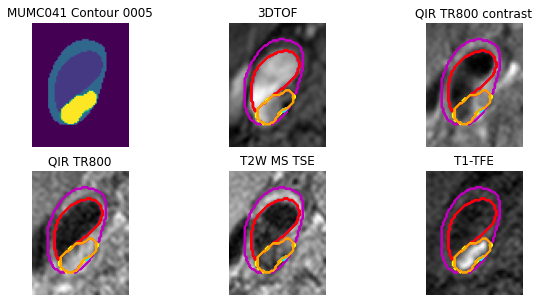

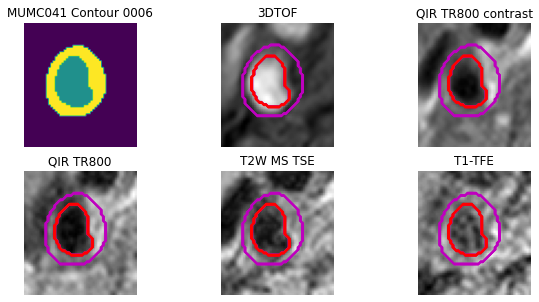

...

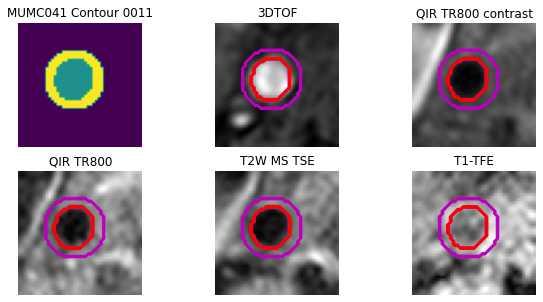

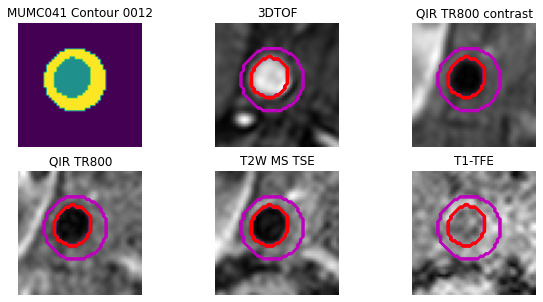

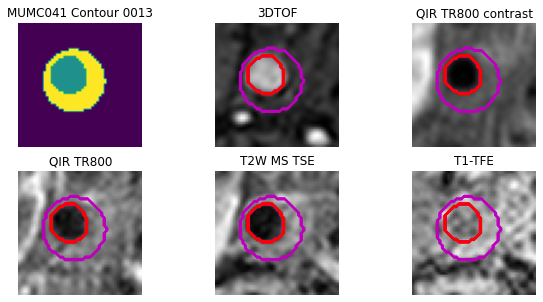

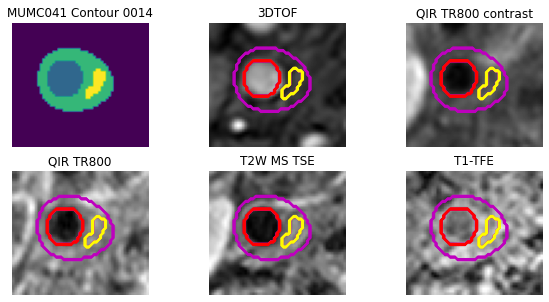

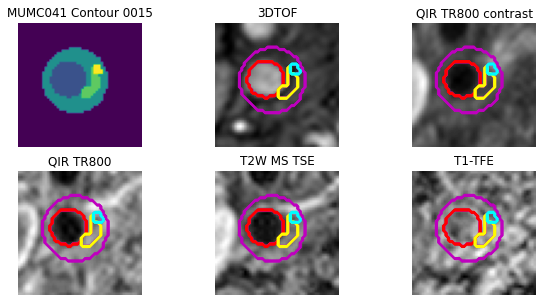

MUMC044 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


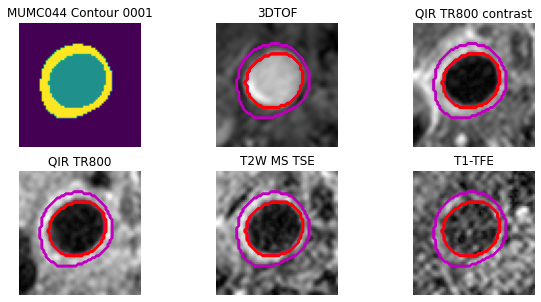

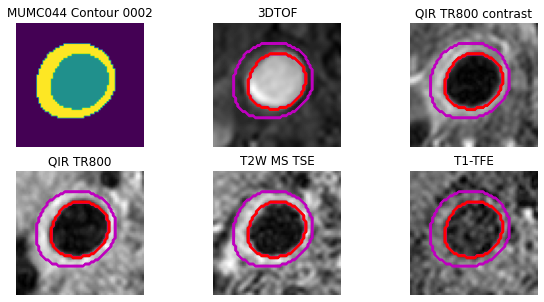

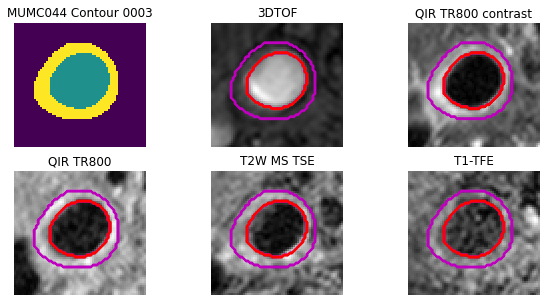

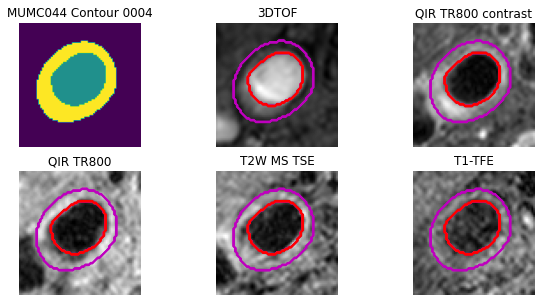

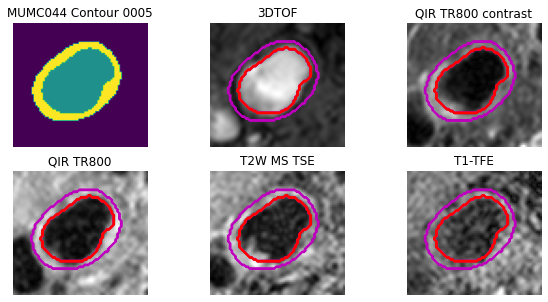

...

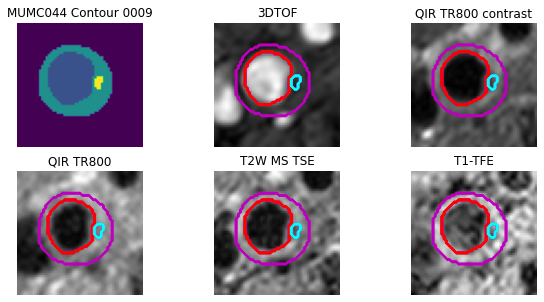

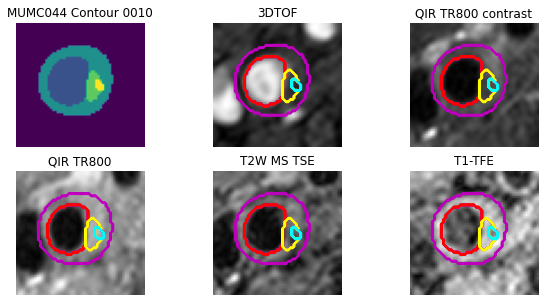

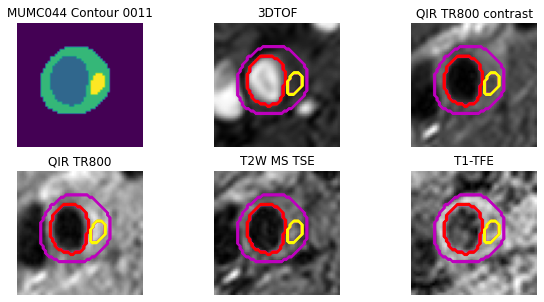

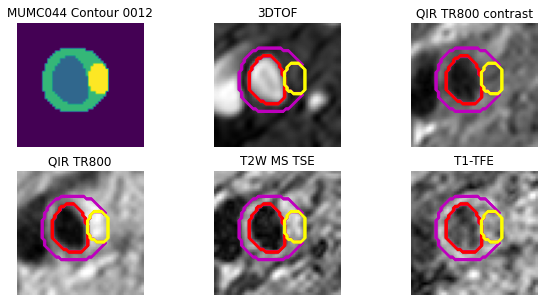

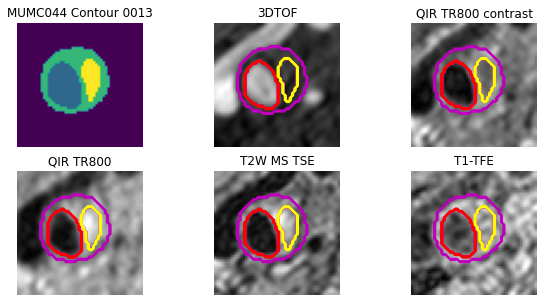

MUMC045 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


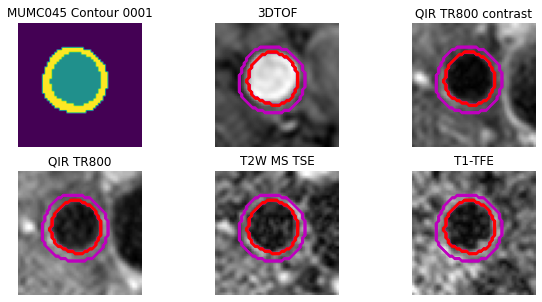

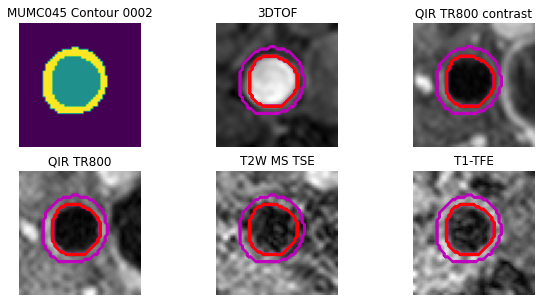

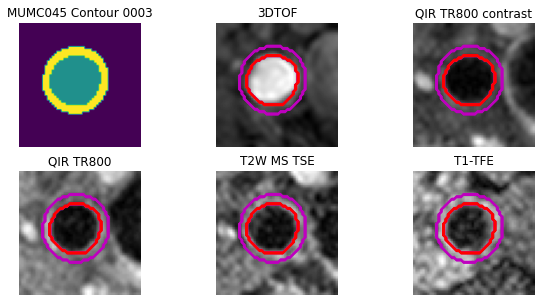

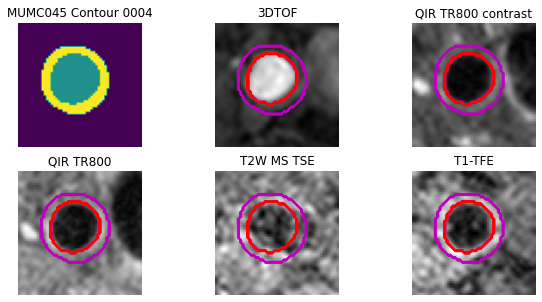

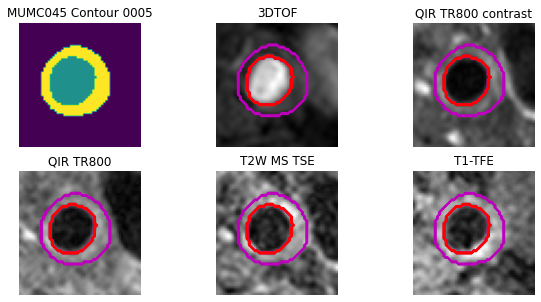

...

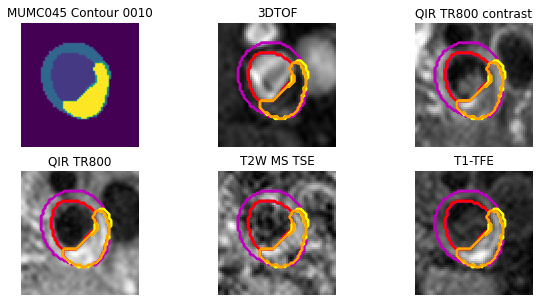

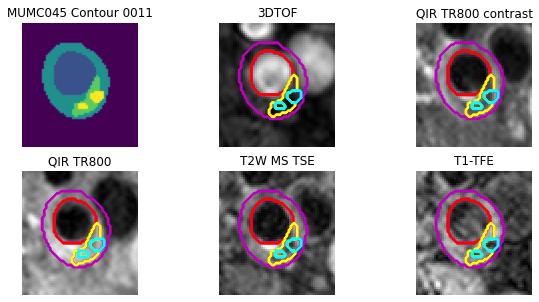

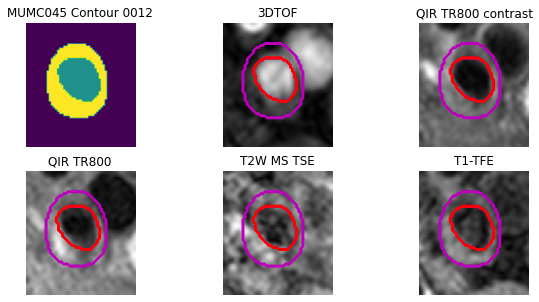

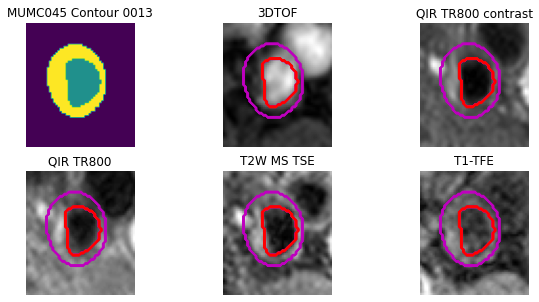

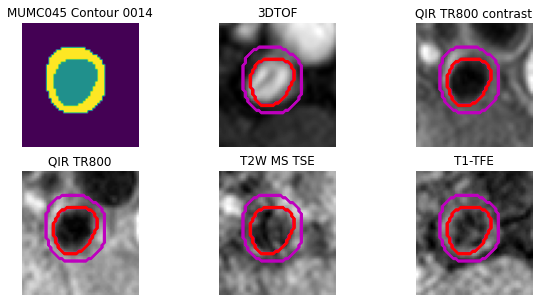

MUMC047 [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


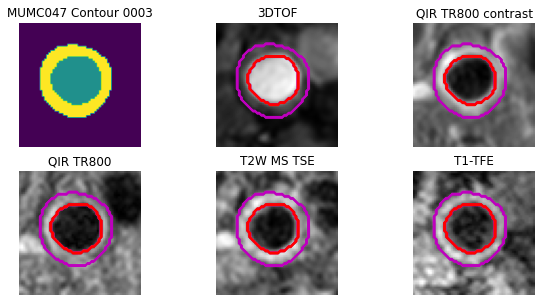

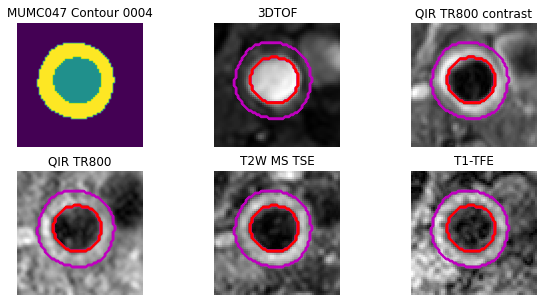

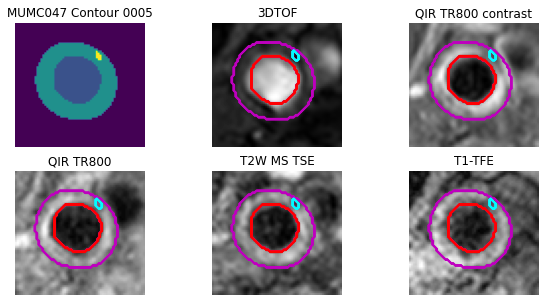

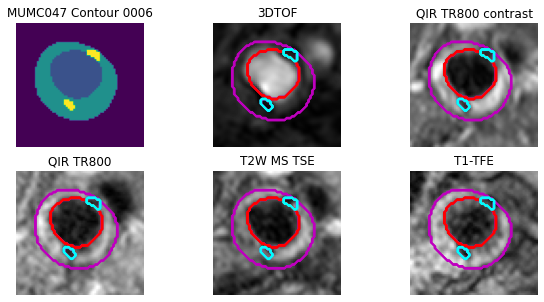

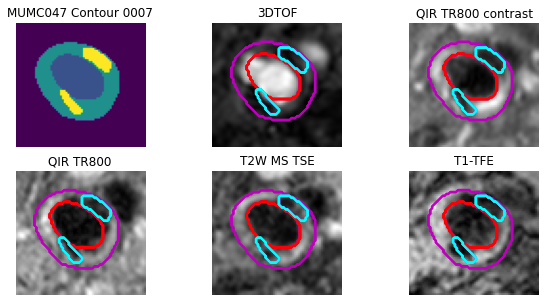

...

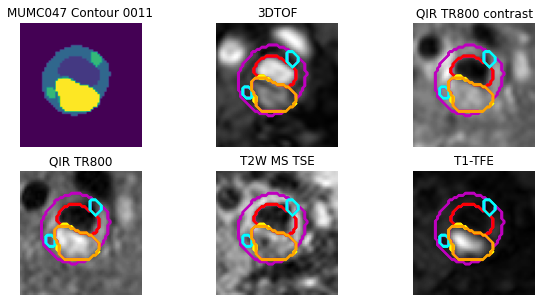

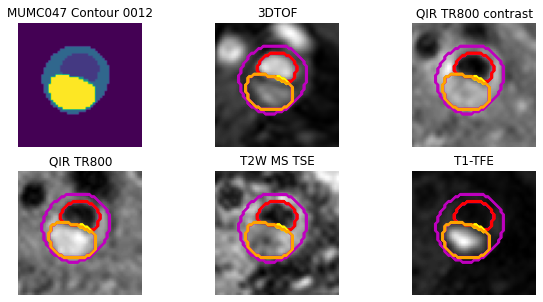

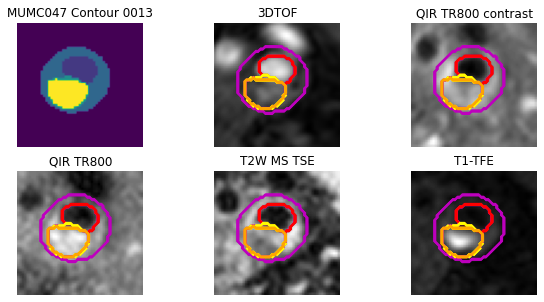

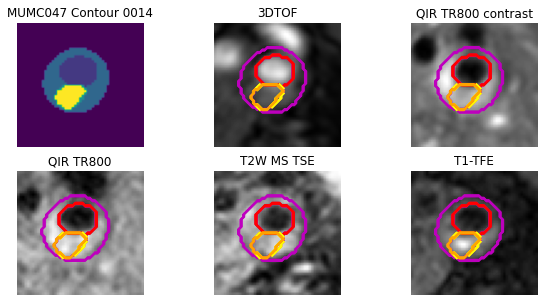

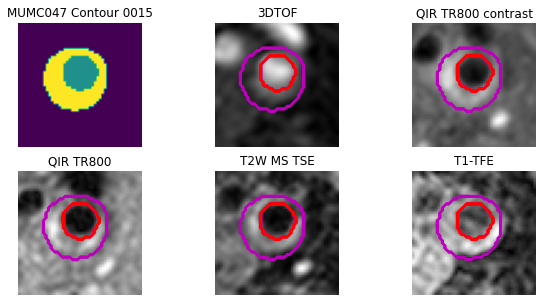

MUMC048 [7, 8, 9, 10, 11, 12, 13, 14, 15]


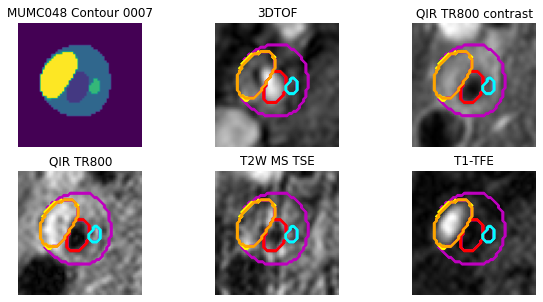

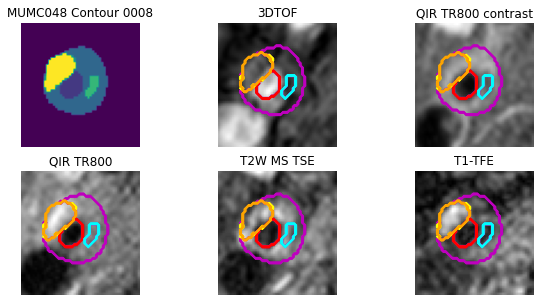

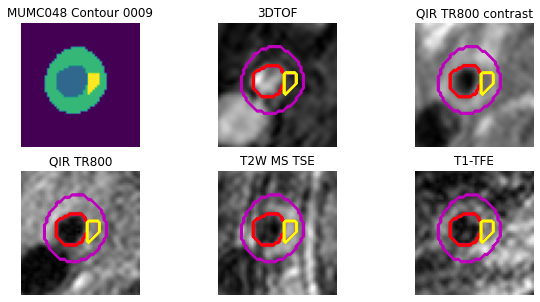

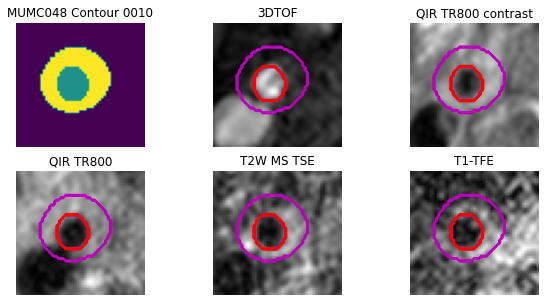

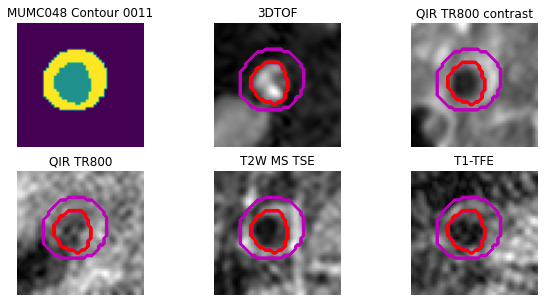

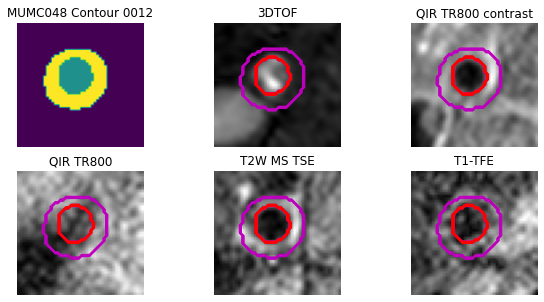

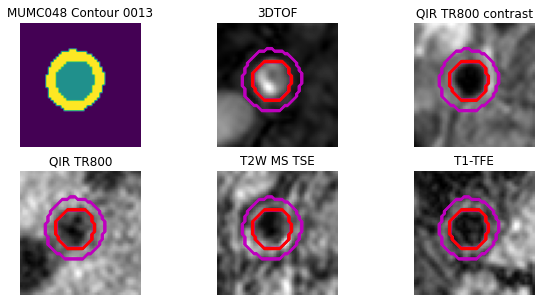

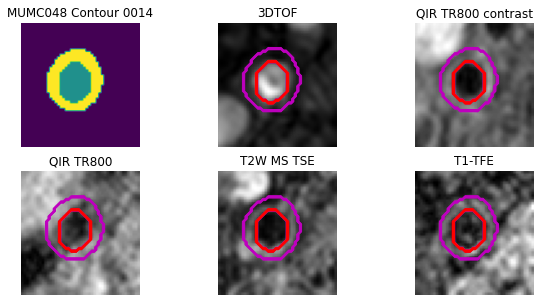

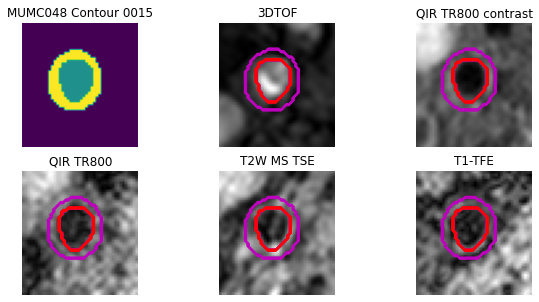

MUMC050 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


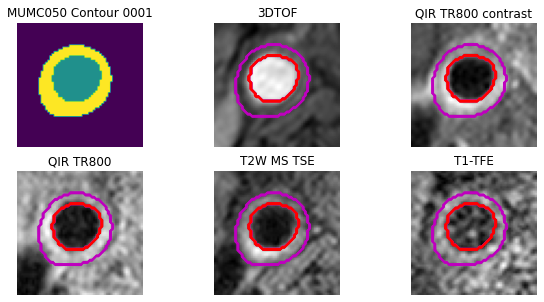

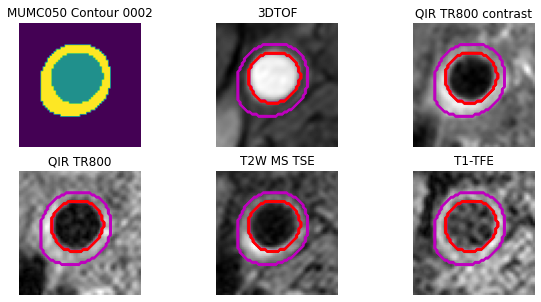

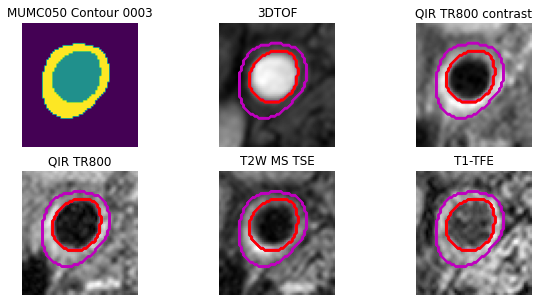

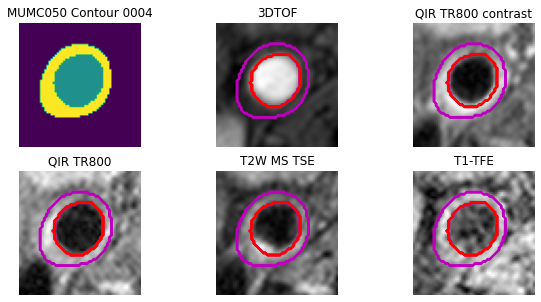

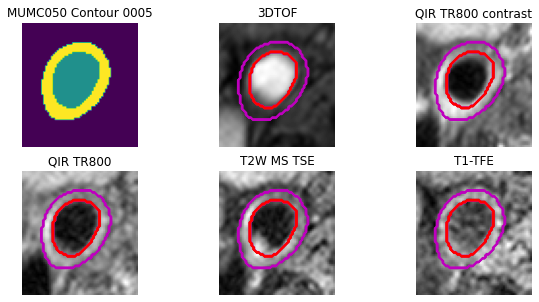

...

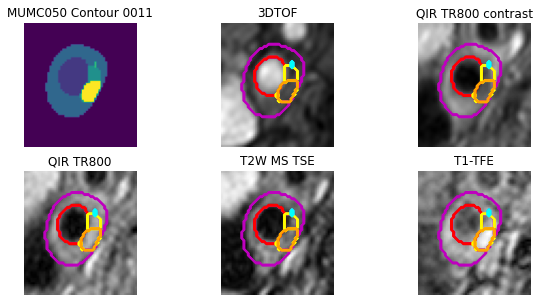

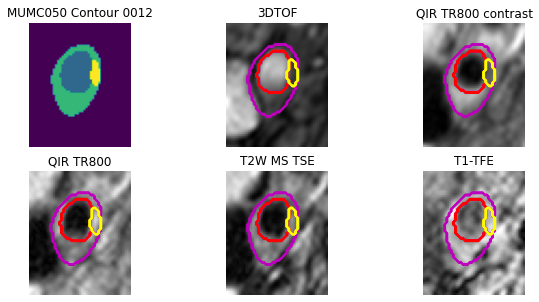

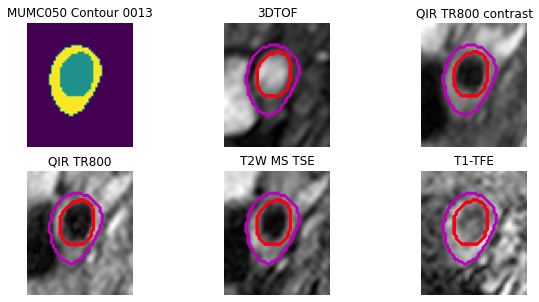

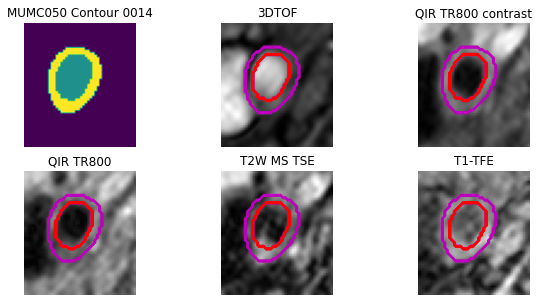

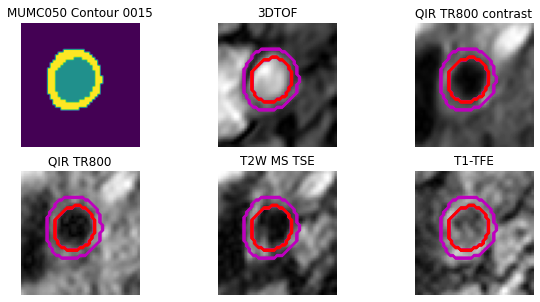

MUMC051 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


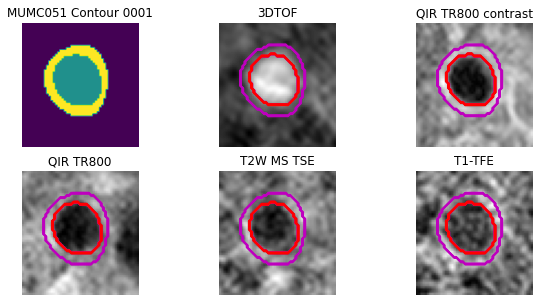

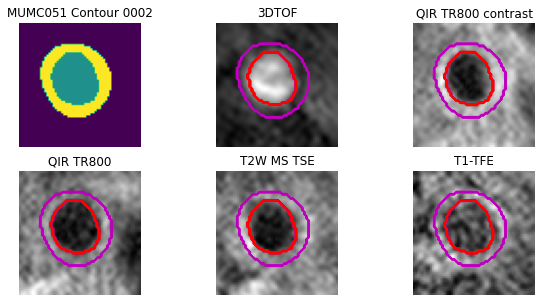

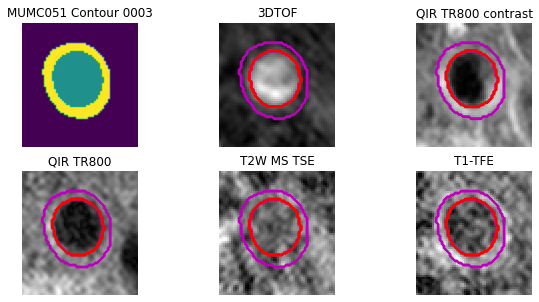

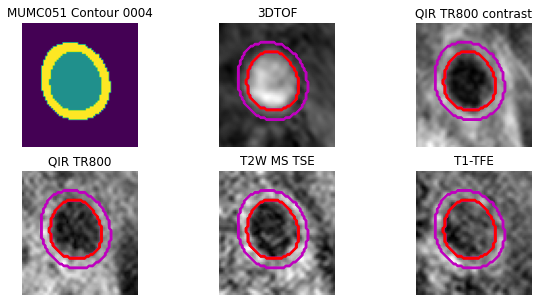

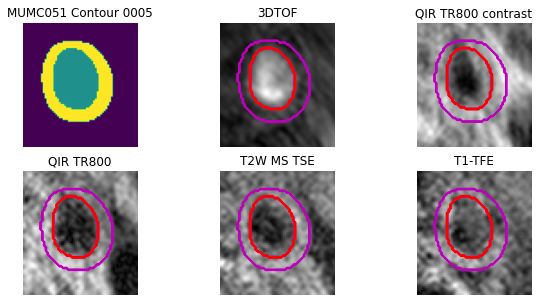

...

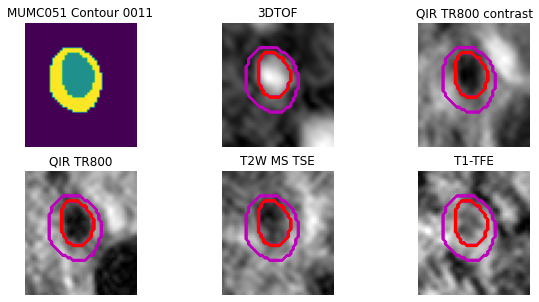

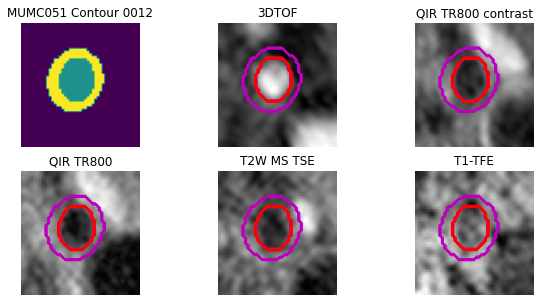

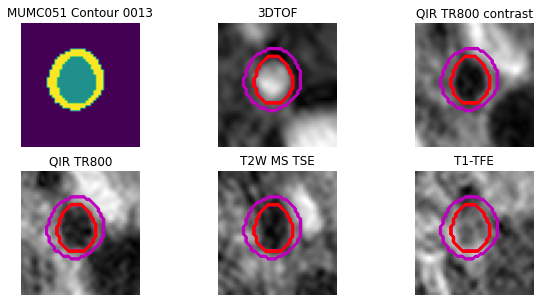

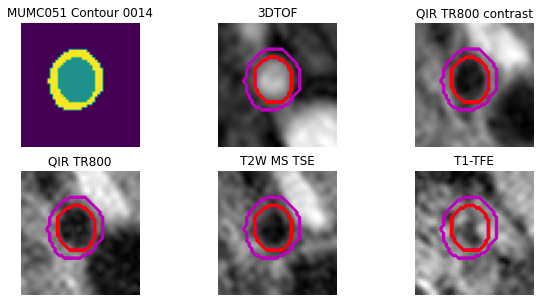

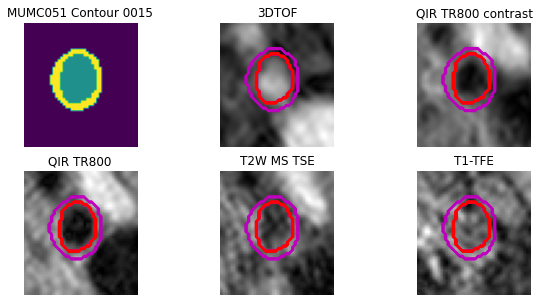

MUMC055 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


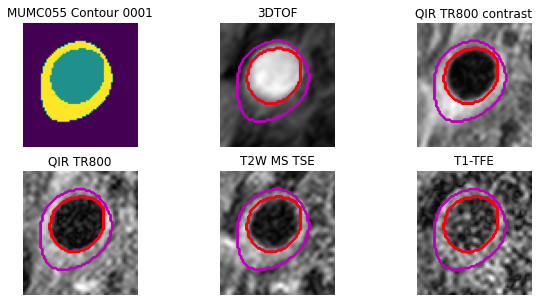

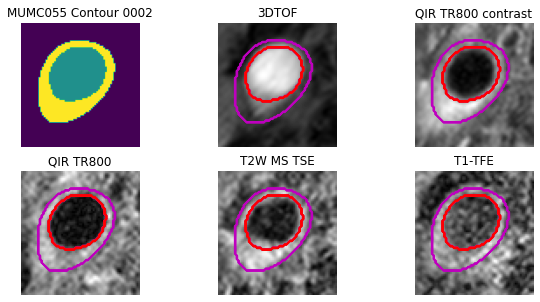

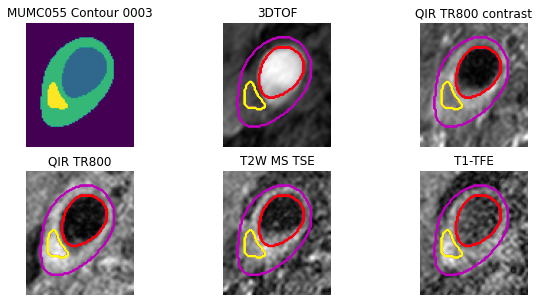

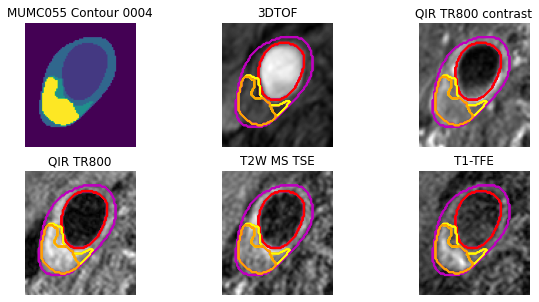

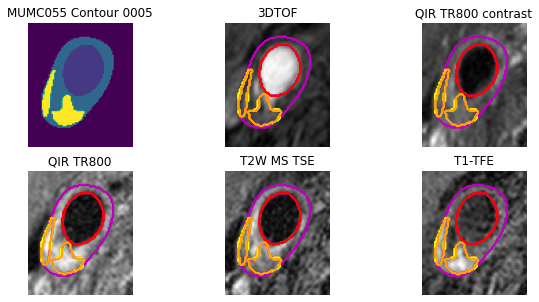

...

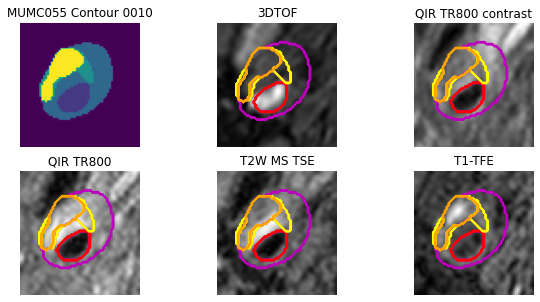

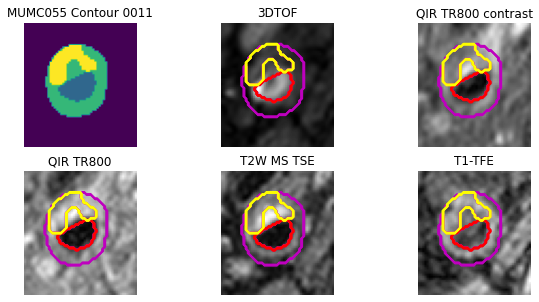

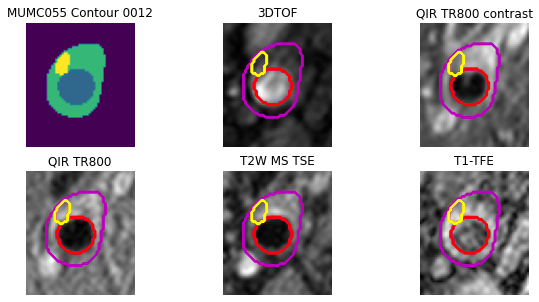

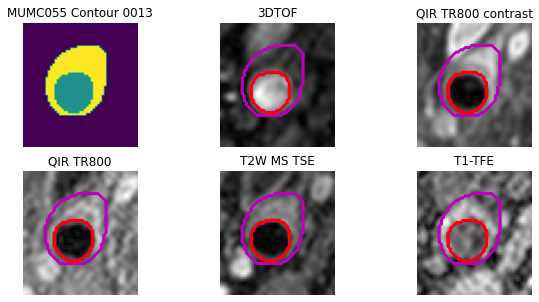

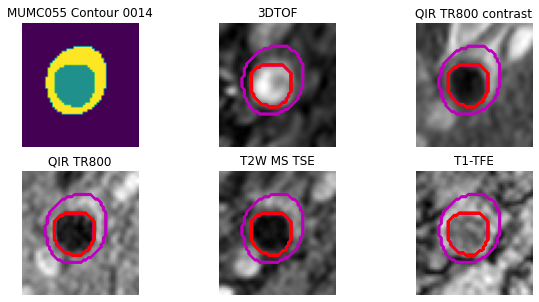

MUMC056 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


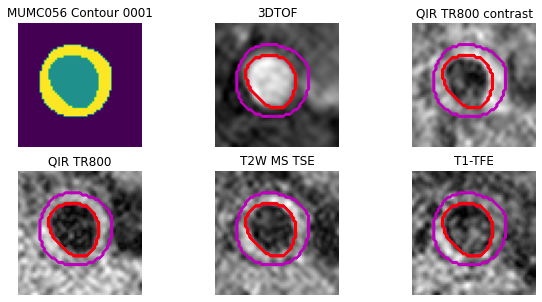

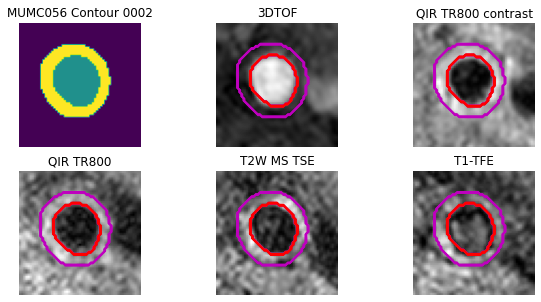

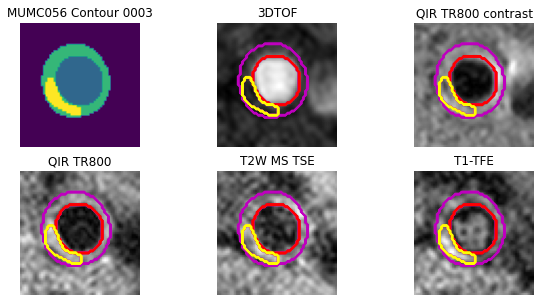

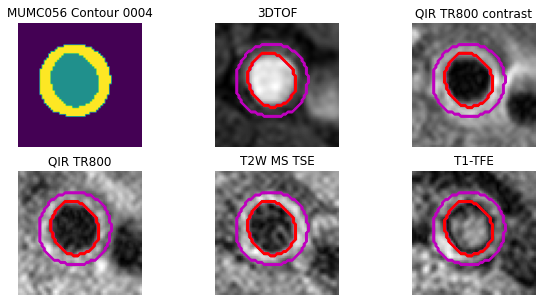

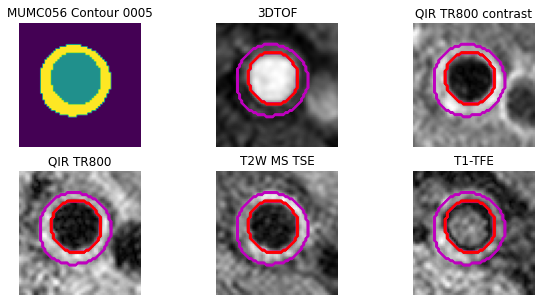

...

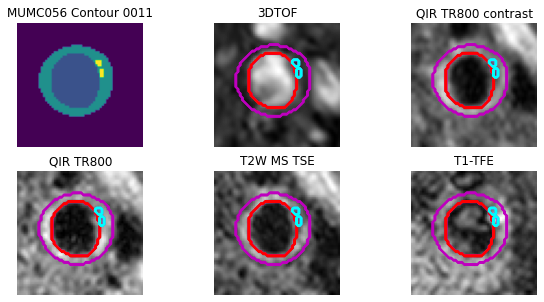

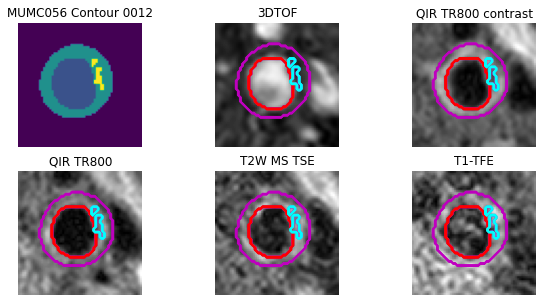

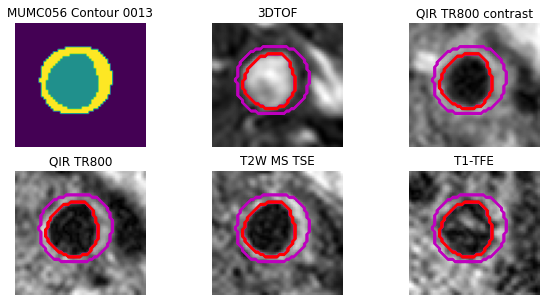

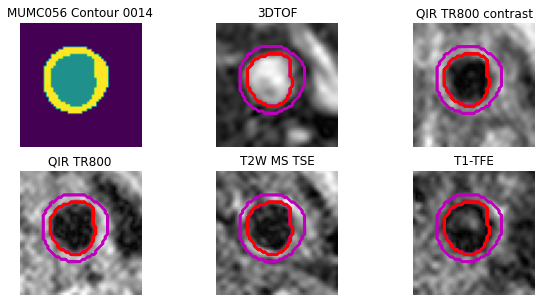

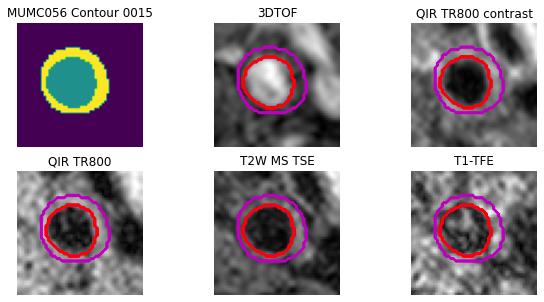

MUMC057 [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]


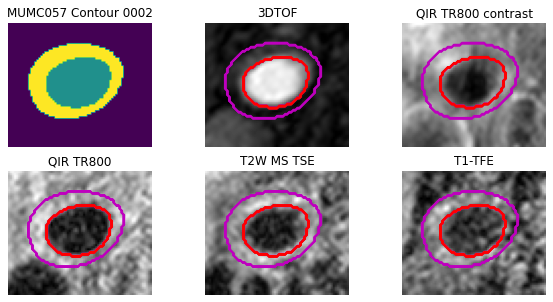

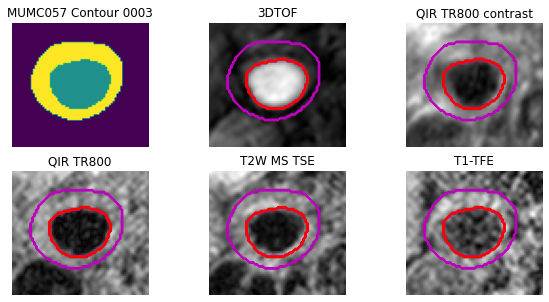

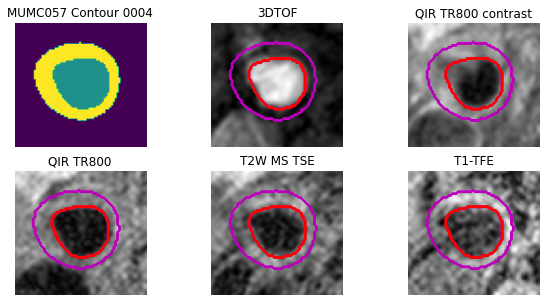

KeyboardInterrupt: 

In [149]:
for item in os.listdir("Z:/Lisa/PARISK/PARISK_curated/"):
    folder = os.path.join("Z:/Lisa/PARISK/PARISK_curated", item)
    if os.path.isdir(folder + '/MASSExport') and (os.path.isdir(folder + '/contours')):
        slices = df_summary['slices'].loc[df_summary['sub'] == item].values[0]
        if len(slices)>0:
            print (item, slices)
            for sl in slices:
                
                con_filename = glob.glob(folder + '/contours/*' + format(sl, '04d') + '.dcm')[0]
                img_filenames = glob.glob(folder + '/MASSExport/*' + format(sl, '04d') + '.dcm')
                
                fig = plt.figure(figsize=(10, 5))

                plt.subplot(2, 3, 1)
                con_dcm = pydicom.read_file(con_filename, force = True)
                con_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
                con = con_dcm.pixel_array
                
                xmin = 1
                ymin = 1
                xmax = con.shape[0]-2
                ymax = con.shape[0]-2
                
                try:
                    xmin = np.min(np.where(con > 0)[0])
                    xmax = np.max(np.where(con > 0)[0])
                    ymin = np.min(np.where(con > 0)[1])
                    ymax = np.max(np.where(con > 0)[1])
                except:
                    pass
                
                plt.imshow(con[xmin-10:xmax+15, ymin-10:ymax+15])
                plt.axis('Off')
                plt.title(item + ' Contour ' + format(sl, '04d'))
                
                counter = 1
                for img_filename in img_filenames:
                    counter += 1
                    plt.subplot(2, 3, counter)
                    img_dcm = pydicom.read_file(img_filename, force = True)
                    img_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
                    plt.imshow(img_dcm.pixel_array[xmin-10:xmax+15, ymin-10:ymax+15], cmap = 'gist_gray')
                    plt.contour((con == 2)[xmin-10:xmax+15, ymin-10:ymax+15], colors = ['m'], linewidths = 1)
                    plt.contour((con == 1)[xmin-10:xmax+15, ymin-10:ymax+15], colors = ['r'], linewidths = 1)
                    plt.contour((con == 3)[xmin-10:xmax+15, ymin-10:ymax+15], colors = ['yellow'], linewidths = 1)
                    plt.contour((con == 4)[xmin-10:xmax+15, ymin-10:ymax+15], colors = ['cyan'], linewidths = 1)
                    plt.contour((con == 6)[xmin-10:xmax+15, ymin-10:ymax+15], colors = ['orange'], linewidths = 1)
                    plt.axis('Off')
                    plt.title(img_dcm.SeriesDescription)
                    
                plt.show()

In [7]:
#import shutil
#folder = 'Z:/Lisa/PARISK/PARISK_curated/'
#for item in os.listdir(folder):
#    path = os.path.join(folder, item)
#    if os.path.isdir(path + '/DICOM/'):
#        shutil.rmtree(path + '/DICOM/')

In [10]:
#for item in os.listdir(folder):
#    path = os.path.join(folder, item)
#    for subitem in os.listdir(path):
#        subpath = os.path.join(path, subitem)
#        if not os.path.isdir(subpath):
#            os.remove(subpath)


In [64]:
#sub = 'MUMC130'
#sls = [15]
#for sl in sls:
#    for file in glob.glob('Z:/Lisa/PARISK/PARISK_curated/' + sub + '/*/*SER*sl' + format(sl, '04d') + '*.dcm'):
#        print (file)
#        os.remove(file)

Z:/Lisa/PARISK/PARISK_curated/MUMC130\contours\SER_1401_sl0015_ph0001.dcm
Z:/Lisa/PARISK/PARISK_curated/MUMC130\MASSExport\SER_1401_sl0015_ph0001.dcm
Z:/Lisa/PARISK/PARISK_curated/MUMC130\MASSExport\SER_1501_sl0015_ph0001.dcm
Z:/Lisa/PARISK/PARISK_curated/MUMC130\MASSExport\SER_1601_sl0015_ph0001.dcm
Z:/Lisa/PARISK/PARISK_curated/MUMC130\MASSExport\SER_1701_sl0015_ph0001.dcm
Z:/Lisa/PARISK/PARISK_curated/MUMC130\MASSExport\SER_1901_sl0015_ph0001.dcm


In [65]:
df = []
for item in os.listdir("Z:/Lisa/PARISK/PARISK_curated/"):
    folder = os.path.join("Z:/Lisa/PARISK/PARISK_curated/", item)
    for filename in os.listdir(folder + '/MASSExport'):
        sl = int(filename.split('_')[-2][2:])
        dcm = pydicom.read_file(folder + '/MASSExport/' + filename, force = True)
        mod = dcm.SeriesDescription
        rec = {'sub': item, 'mod': mod, 'sl': sl}
        df.append(rec)
    for filename in os.listdir(folder + '/contours'):
        sl = int(filename.split('_')[-2][2:])
        rec = {'sub': item, 'mod': 'con', 'sl': sl}
        df.append(rec)

In [66]:
df = pd.DataFrame(df)

In [69]:
np.unique(np.array(list(df['mod'])))

array(['3DTOF', 'QIR TR800', 'QIR TR800 + contrast', 'QIR TR800 contrast',
       'T1-TFE', 'T1W 2D DIR', 'T1W 2D DIR + contrast', 'T2W MS TSE',
       'con'], dtype='<U22')

In [79]:
for item in os.listdir("Z:/Lisa/PARISK/PARISK_curated/"):
    folder = os.path.join("Z:/Lisa/PARISK/PARISK_curated/", item)
    for filename in os.listdir(folder + '/MASSExport'):
        sl = int(filename.split('_')[-2][2:])
        dcm = pydicom.read_file(folder + '/MASSExport/' + filename, force = True)
        mod = dcm.SeriesDescription
        new_mod = ''
        if '3DTOF' in mod:
            new_mod = '3DTOF'
        if 'QIR TR800' in mod:
            new_mod = 'T1W'
        if 'T1-TFE' in mod:
            new_mod = 'TFE'
        if 'T1W 2D DIR' in mod:
            new_mod = 'T1W'
        if 'T2W MS TSE' in mod:
            new_mod = 'T2W'
        if 'QIR TR800 + contrast' in mod:
            new_mod = 'contrastT1W'
        if 'QIR TR800 contrast' in mod:
            new_mod = 'contrastT1W'
        if 'T1W 2D DIR + contrast' in mod:
            new_mod = 'contrastT1W'
        if len(new_mod)>0:
            os.rename(folder + '/MASSExport/' + filename, 
                      folder + '/MASSExport/' + new_mod + '_' + filename.split('_')[-2][2:] + '.dcm')
        else:
            print (folder + '/MASSExport/' + filename)

    for filename in os.listdir(folder + '/contours'):
        os.rename(folder + '/contours/' + filename, 
                  folder + '/contours/' + 'con_' + filename.split('_')[-2][2:] + '.dcm')
        

In [102]:
sub = 'MUMC040'
ser = '1601'
mod = 'contrastT1W'
for filename in glob.glob('Z:/Lisa/PARISK/PARISK_curated/' + sub + '/MASSExport/*SER_' + ser + '*sl*.dcm'):
    sl = filename.split('_')[-2][2:]
    os.rename(filename, 'Z:/Lisa/PARISK/PARISK_curated/' + sub + '/MASSExport/' + mod + '_' + sl + '.dcm')

In [101]:
sub = 'MUMC040'
mod = 'con'
for filename in glob.glob('Z:/Lisa/PARISK/PARISK_curated/' + sub + '/contours/*SER_*sl*.dcm'):
    sl = filename.split('_')[-2][2:]
    os.rename(filename, 'Z:/Lisa/PARISK/PARISK_curated/' + sub + '/contours/' + mod + '_' + sl + '.dcm')

In [48]:
df_num_slices = []
for item in os.listdir("Z:/Lisa/PARISK/PARISK_curated/"):
    folder = os.path.join("Z:/Lisa/PARISK/PARISK_curated/", item)
    rec = {'sub': item, 'num': len(os.listdir(folder + '/contours/'))}
    df_num_slices.append(rec)

In [49]:
df_num_slices = pd.DataFrame(df_num_slices)
df_num_slices

,sub,num
0,MUMC011,14
1,MUMC013,15
2,MUMC014,14
3,MUMC015,14
4,MUMC016,14
5,MUMC017,14
6,MUMC019,13
7,MUMC020,14
8,MUMC021,14
9,MUMC022,14


In [57]:
np.sum(np.array(list(df_num_slices[:56]['num'])))

761

In [107]:
ch1_name = "Z:/Lisa/PARISK/PARISK_curated/MUMC011/MASSExport/T1W_0002.dcm"
ch2_name = "Z:/Lisa/PARISK/PARISK_curated/MUMC011/MASSExport/T2W_0002.dcm"
ch3_name = "Z:/Lisa/PARISK/PARISK_curated/MUMC011/MASSExport/TOF_0002.dcm"

ch1_dcm = pydicom.read_file(ch1_name, force = True)
ch2_dcm = pydicom.read_file(ch2_name, force = True)
ch3_dcm = pydicom.read_file(ch3_name, force = True)

ch1_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
ch2_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
ch3_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian

ch1_img = ch1_dcm.pixel_array
ch2_img = ch2_dcm.pixel_array
ch3_img = ch3_dcm.pixel_array

In [154]:
ch1_min = np.min(ch1_img)
ch1_max = np.max(ch1_img)

ch2_min = np.min(ch2_img)
ch2_max = np.max(ch2_img)

ch3_min = np.min(ch3_img)
ch3_max = np.max(ch3_img)

ch1_img = ((ch1_img - ch1_min)/(ch1_max - ch1_min)*255).astype(np.uint8)
ch2_img = ((ch2_img - ch2_min)/(ch2_max - ch2_min)*255).astype(np.uint8)
ch3_img = ((ch3_img - ch3_min)/(ch3_max - ch3_min)*255).astype(np.uint8)

In [155]:
chs_img = np.dstack((ch1_img, ch2_img, ch3_img))

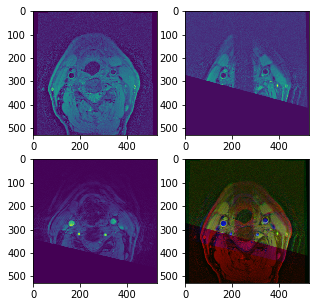

In [156]:
plt.figure(figsize=(5, 5))

plt.subplot(2, 2, 1)
plt.imshow(ch1_img)

plt.subplot(2, 2, 2)
plt.imshow(ch2_img)

plt.subplot(2, 2, 3)
plt.imshow(ch3_img)

plt.subplot(2, 2, 4)
plt.imshow(chs_img)